# Flats [Feb 2019] - Blue array

This reduction includes the data taken before the FIFI-LS series in Feb-Mar 2019.

The method followed to obtain the flats is the following:

1. First, for each spaxel $i$, I obtain a median spectrum: $f_i (\lambda) $ using all the spexels $i, j$ with $j=0,15$.

2. Then, I obtain a median spectrum from all the spaxels  $f (\lambda)$ assuming a series of constant factors to scale the different spaxel spectra to a median spectrum. I call these factors spatial flats ($flat_{spat; i}$).

3. At this point, I go back to the original spexels and obtain the spectral relative response (or spectral flat)
using the ratios:   $flat_{spec; i, j} (\lambda) = f (\lambda) / f_{i, j} (\lambda)$.

4. At the end, I merge the spaxel spectral flat and spexels spectral flat to obtain a merged one.

In this way, I obtain a cube of spectral responses and an array of spatial flats.
The spectral responses should be computable from laboratory values. The spatial flats depend on the illumination of 
the array and, in principle, can vary between laboratory and sky.
Also, I obtain a spatial flat for each calibration series and only one spectral flat common to all the series.


In [1]:
# Used if in non-interactive mode to skip tests
Test = False

# Blue

## Step 0

Compute the spectra from the slopes.

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
from fifipy.io import readSlopeFits
from fifipy.spectra import computeMedianSpatialSpectra, computeSplineFits
import numpy as np

caldirs = ['/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_10_2018/',
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_08_2018/',
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2018/',
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2019/',
          '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_03_2017/'
          ]
signs = [1, -1, -1, -1, 1]
cfiles = [['D105M1','D105M1_1','D105M2','D130M1','D130M1_1','D130M2'],
         ['D105M1','D105M2','D130M1','D130M1_2','D130M2'],
         ['D105M1_1','D105M1_2','D105M1_3','D105M2_1','D105M2_2','D130M1_1','D130M2_1','D130M2_2'],
         ['D105M1_1','D105M2_1','D130M1_1','D130M2_1'],
        ['D105M1','D105M2','D130M1','D130M2']
         ]
orders = [[1,1,2,1,1,2],
          [1,2,1,1,2],
          [1,1,1,2,2,1,2,2],
         [1,2,1,2],
          [1,2,1,2]
         ]
dichroics = [[105,105,105,130,130,130],
             [105,105,130,130,130],
             [105,105,105,105,105,130,130,130],
            [105,105,130,130],
             [105,105,130,130]
            ]
dates = [['10/18','10/18','10/18','10/18','10/18','10/18'],
         ['8/18','8/18','8/18','8/18','8/18'],
        ['2/18','2/18','2/18','2/18','2/18','2/18','2/18','2/18'],
         ['2/19','2/19','2/19','2/19'],
         ['3/17']*4
        ]

wmin = 80
wmax = 80
wmin2 = 60
wmax2 = 60
wmin1 = 80
wmax1 = 80
for files, caldir, order in zip(cfiles, caldirs, np.concatenate(orders)):
    for file in files:
        g, w, dw, s = readSlopeFits(caldir, file+'.fits')
        wmin_ = np.nanmin(w); wmax_ = np.nanmax(w)
        if wmin_ < wmin: wmin = wmin_
        if wmax_ > wmax: wmax = wmax_
        if order == 1:
            if wmin_ < wmin1: wmin1 = wmin_
            if wmax_ > wmax1: wmax1 = wmax_
        else:
            if wmin_ < wmin2: wmin2 = wmin_
            if wmax_ > wmax2: wmax2 = wmax_      

print('w min ', wmin, ' w max ', wmax)
print('w min 1 ', wmin1, ' w max 1', wmax1)
print('w min 2 ', wmin2, ' w max 2', wmax2)
waves1 = []
spectra1 = []
waves2 = []
spectra2 = []
waves = []
spectra = []
# Compute wavelength grid
wave, spectrum = computeSplineFits(w,dw,s,'B1', wmin, wmax, delta=0.3)
for files, caldir, sign, order, dichroic in zip(cfiles, caldirs, signs, orders, dichroics):
    for file, o, d in zip(files, order, dichroic):
        g, w, dw, s = readSlopeFits(caldir, file+'.fits')
        if o == 1:
            mode = 'B1'
            wmin_ = wmin1
            wmax_ = wmax1
        else:
            mode = 'B2'
            wmin_ = wmin2
            wmax_ = wmax2
        wave_, spectrum_ = computeSplineFits(w, dw, s, mode, wmin_, wmax_, delta=0.3)
        # Interpolate on grid
        spectrum = np.full([400,len(wave)], np.nan)
        idx, = np.where((wave > np.nanmin(wave_)) & (wave < np.nanmax(wave_)))
        for i in range(400):
            spectrum[i,idx] = np.interp(wave[idx], wave_, spectrum_[i,:])
                
        #print('length of wave ',len(wave))
        # Filter low signal parts
        if o == 1:
            if d == 105:
                idx = (wave < 72) | (wave > 100)
                spectrum[:,idx] = np.nan
            else:
                idx = (wave < 70)
                spectrum[:,idx] = np.nan                
        else:
            if d == 105:
                idx = (wave < 52) | (wave > 72)
                spectrum[:,idx] = np.nan
            else:
                idx = ((wave > 53) & (wave < 58)) | (wave > 70)
                spectrum[:,idx] = np.nan
        waves.append(wave)
        spectra.append(spectrum * sign)
        if o == 1:
            waves1.append(wave_)
            spectra1.append(spectrum_ * sign)
        else:
            waves2.append(wave_)
            spectra2.append(spectrum_ * sign)
            
spectra = np.array(spectra)
spectra1 = np.array(spectra1)
spectra2 = np.array(spectra2)

spatspectra = []
for spectrum in spectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)
spatspectra = np.array(spatspectra)

spatspectra1 = []
for spectrum in spectra1:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra1.append(spatspectrum)
spatspectra1 = np.array(spatspectra1)
spatspectra2 = []
for spectrum in spectra2:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra2.append(spatspectrum)
spatspectra2 = np.array(spatspectra2)


# Concatenate
orders = np.concatenate(orders)
dichroics = np.concatenate(dichroics)
dates = np.concatenate(dates)

idx = orders == 1
dichroics1 = dichroics[idx]
dichroics2 = dichroics[~idx]
dates1 = dates[idx]
dates2 = dates[~idx]

w min  47.83391608350798  w max  130.85043306326145
w min 1  47.83391608350798  w max 1 130.85043306326145
w min 2  47.84205509220851  w max 2 125.95161701138025


/Users/dfadda/Python/fifipy/fifipy/spectra.py:87: RuntimeWarning: Mean of empty slice
  mspec = np.nanmean(spec[m],axis=0)
/Users/dfadda/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3405: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:80: RuntimeWarning: Mean of empty slice
  d.append(np.nanmean(np.array(r)))
/Users/dfadda/Python/fifipy/fifipy/spectra.py:84: RuntimeWarning: invalid value encountered in less
  m = np.abs(d-med) < 3*mad


In [3]:
# Grab Christian's flats
chrisdir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/Christian/flats/'
wch = np.arange(52,117,1)
nw_ = np.size(wch)
f105 = np.ones((nw_,25,16))
f130 = np.ones((nw_,25,16))
ff105 = np.ones((nw_,25))
ff130 = np.ones((nw_,25))

nw = range(nw_)
for w,i in zip(wch,nw):
    wstr = str(w)
    try:
        f = np.loadtxt(chrisdir+wstr+'/flat.txt')
        f105[i,:,:] = f
        f = np.loadtxt(chrisdir+wstr+'/flatfield.txt')
        ff105[i,:] = f
    except:
        pass
    try:
        f = np.loadtxt(chrisdir+wstr+'_D130/flat.txt')
        f130[i,:,:] = f
        f = np.loadtxt(chrisdir+wstr+'_D130/flatfield.txt')
        ff130[i,:] = f
    except:
        pass
print(np.shape(f130))

(65, 25, 16)


# Step 1

Compute illumination pattern (spatial flat).

In the comparison with Christian's flats, the difference comes from the fact that I excluded a few spaxels (badly illuminated) when computing the median spectrum while he included all the spaxels.


/Users/dfadda/Python/fifipy/fifipy/stats.py:18: RuntimeWarning: invalid value encountered in greater_equal
  mask = (np.abs(u) >= 1)
/Users/dfadda/Python/fifipy/fifipy/stats.py:21: RuntimeWarning: invalid value encountered in true_divide
  return M.squeeze() + np.nansum(d * u, axis=axis) / np.nansum(u, axis=axis)


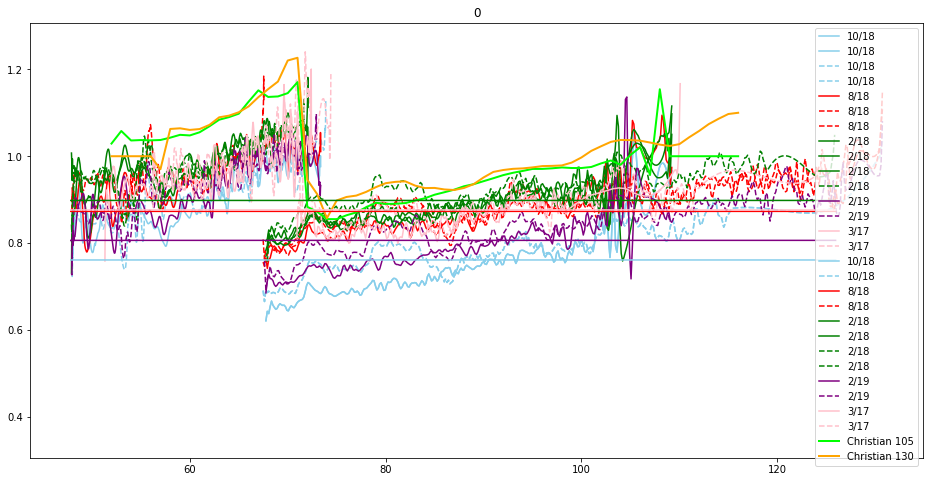

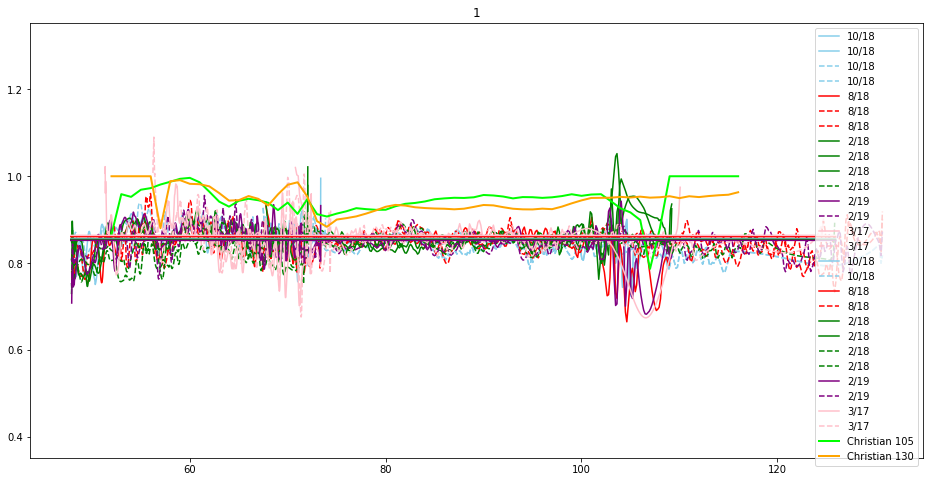

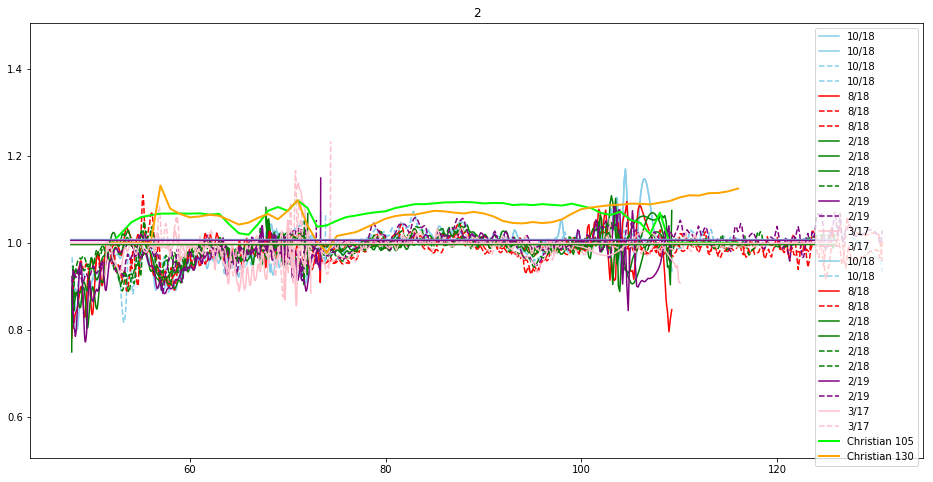

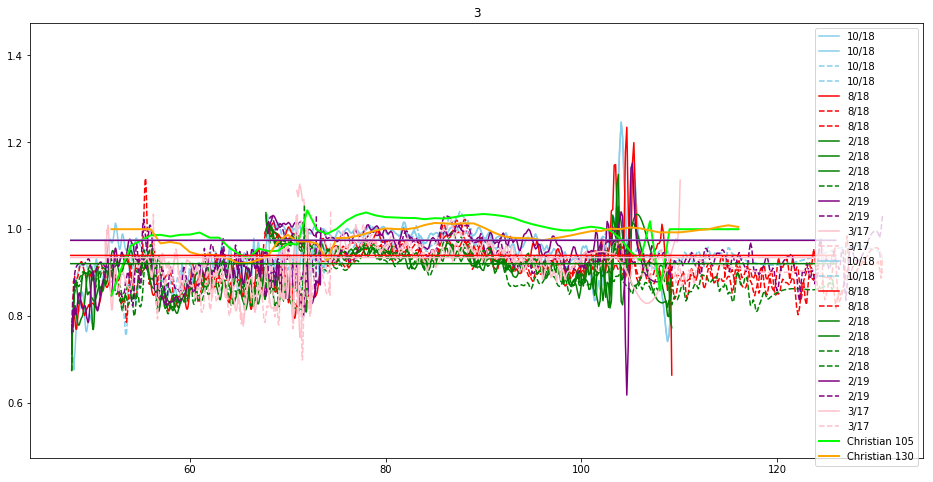

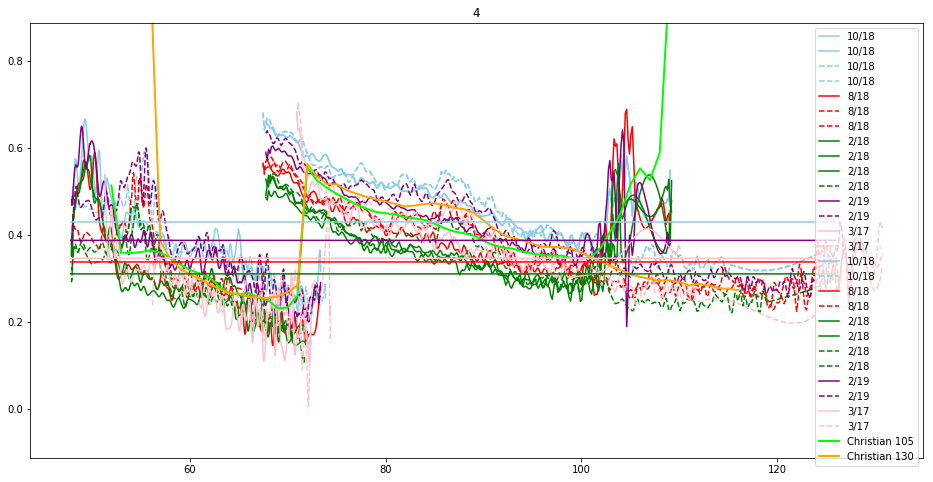

...

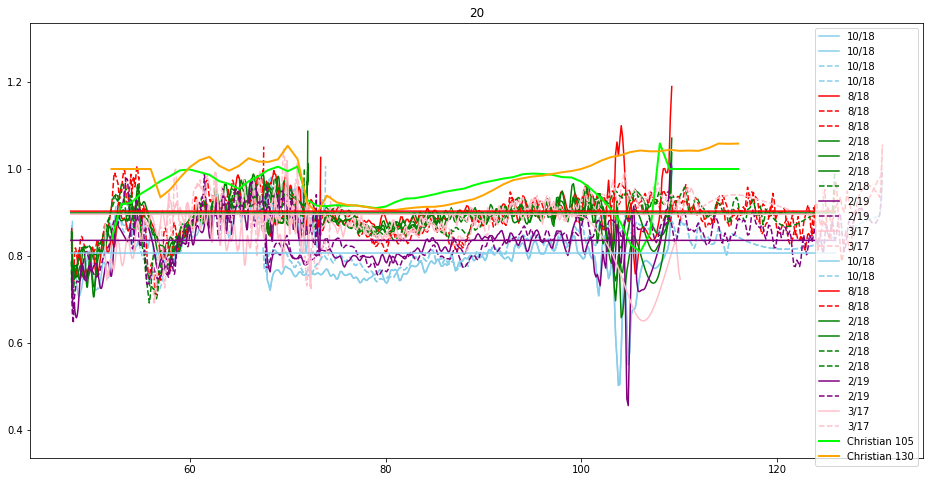

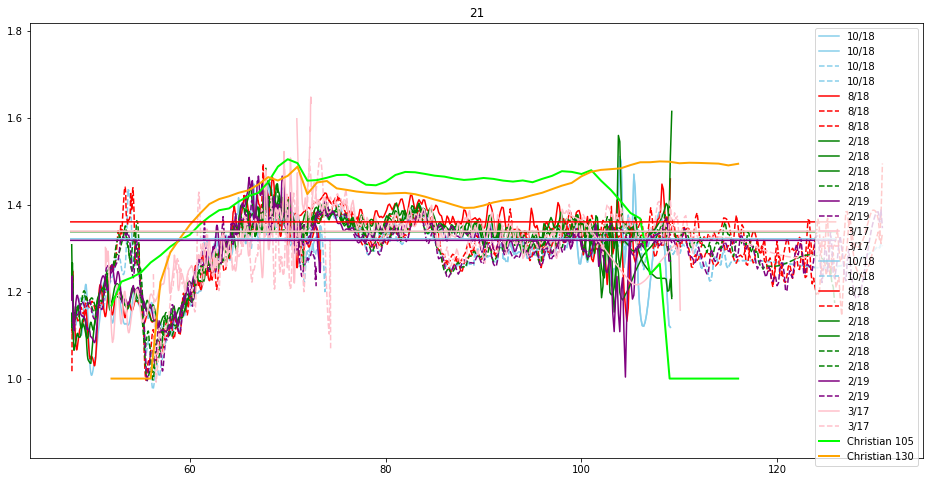

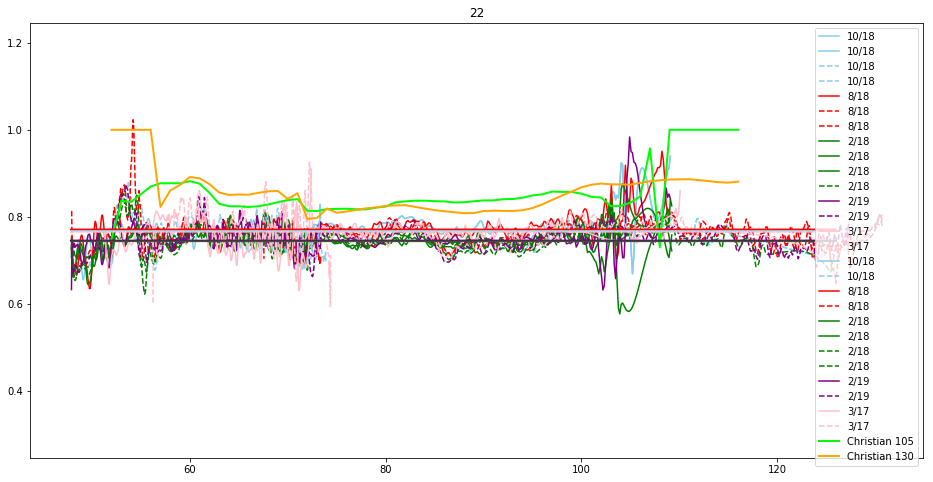

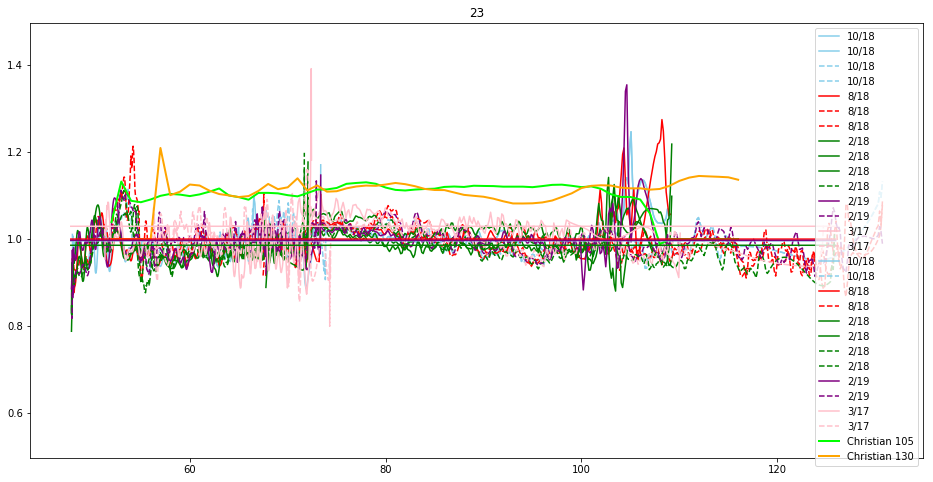

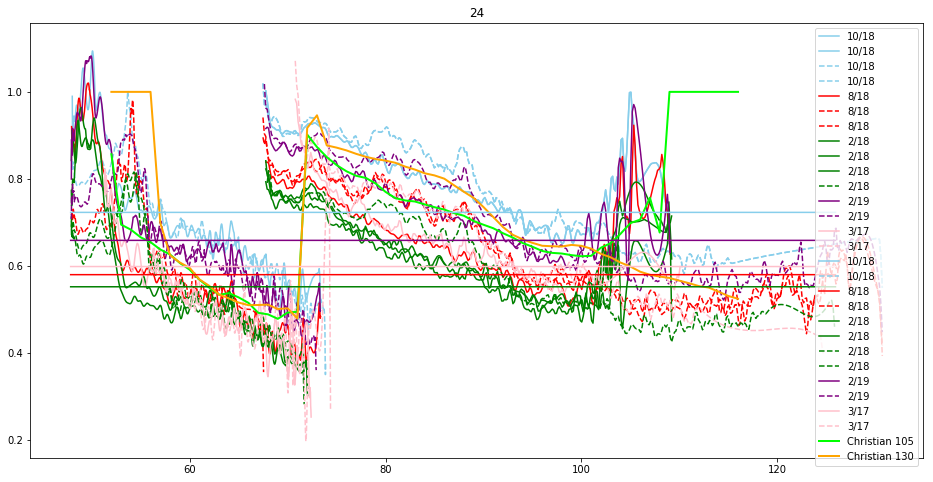

In [4]:
# Plot of  median spaxel spectra over median total spectra (except bad illuminated column)
from fifipy.stats import biweightLocation

s1 = np.ones(25)
s2 = np.ones(25)
s3 = np.ones(25)
s4 = np.ones(25)
s5 = np.ones(25)

#mask = [1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
mask = [1,2,6,7,8,11,12,13,16,17,20,21,22]
#mask = range(25)
for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    m1 = []
    m2 = []
    m3 = []
    m4 = []
    m5 = []
    for w, s, d, dic in zip(waves1, spatspectra1, dates1, dichroics1):
        meds = biweightLocation(s[mask,:], axis = 0)
        idw = (w > 85) & (w < 100)
        m = biweightLocation(s[ispax,idw]/meds[idw])    
        if d == '10/18':
            color='skyblue'
            if dic == 105:
                m1.append(m)
        elif d == '8/18':
            color='red'
            if dic == 105:
                m2.append(m)
        elif d == '2/18':
            color='green'
            if dic == 105:
                m3.append(m)
        elif d == '3/17':
            color='pink'
            if dic == 105:
                m4.append(m)
        elif d == '2/19':
            color='purple'
            if dic == 105:
                m5.append(m)
        else:
            color='black'
        if dic == 105:
            line = '-'
        else:
            line = '--'
        ax.plot(w, s[ispax,:]/meds, line, label = d, color=color)
    for w, s, d, dic in zip(waves2, spatspectra2, dates2, dichroics2):
        meds = biweightLocation(s[mask,:], axis = 0)
        idw = (w > 50) & (w < 66)
        m = biweightLocation(s[ispax,idw]/meds[idw])    
        if d == '10/18':
            color='skyblue'
        elif d == '8/18':
            color='red'
        elif d == '2/18':
            color='green'
        elif d == '3/17':
            color='pink'
        elif d == '2/19':
            color='purple'
        else:
            color='black'
        if dic == 105:
            line = '-'
        else:
            line = '--'
        ax.plot(w, s[ispax,:]/meds, line, label = d, color=color)
    ax.plot(wch, ff105[:,ispax],color='lime',label='Christian 105',linewidth=2)
    ax.plot(wch, ff130[:,ispax],color='orange',label='Christian 130',linewidth=2)
    ax.legend()
    ax.set_title(str(ispax))
    for m, col, s in zip([m1,m2,m3,m4,m5],['skyblue','red','green','pink','purple'],[s1,s2,s3,s4,s5]):
        m = np.array(m)
        medm = np.nanmedian(m)
        if np.isfinite(medm):
            ax.set_ylim(medm-0.5, medm+0.5)
            ax.plot(w, np.full(len(w), medm), color=col)
            s[ispax] = medm
        else:
            s[ispax] = 1.
    plt.show()


## Step 2

Compute spectral flat which applies to the single spaxel.
This will depend on the order and dichroic, possibly because there is component of grating efficiency varying with order and different transmittance of the dichroic. 

We will get rid of this dependency to compute the "real" spectral flat inside each spaxel by using all dichroic and orders. "Real" means due only to the different response of the spexels, not to varying illumination at different wavelengths.

/Users/dfadda/Python/fifipy/fifipy/stats.py:16: RuntimeWarning: invalid value encountered in true_divide
  u = d / (c * mad)
/Users/dfadda/Python/fifipy/fifipy/stats.py:16: RuntimeWarning: divide by zero encountered in true_divide
  u = d / (c * mad)


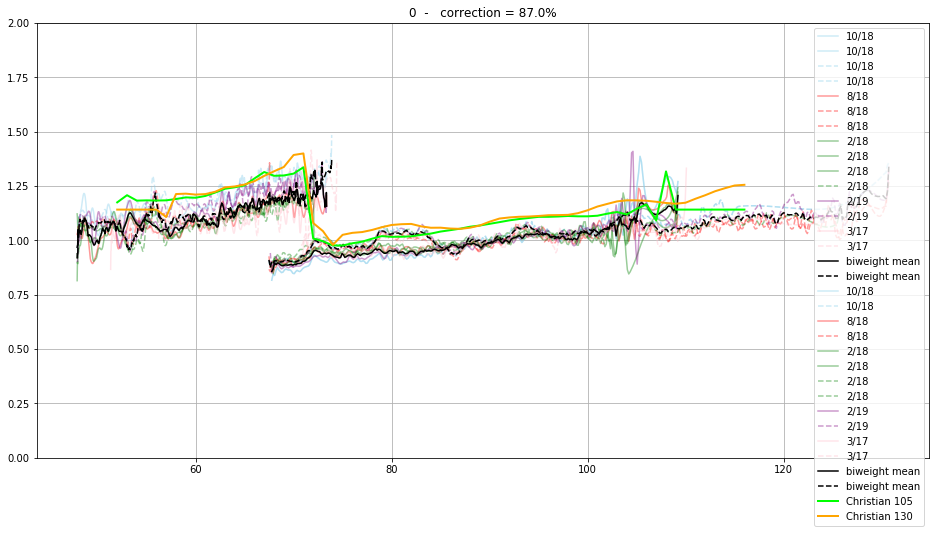

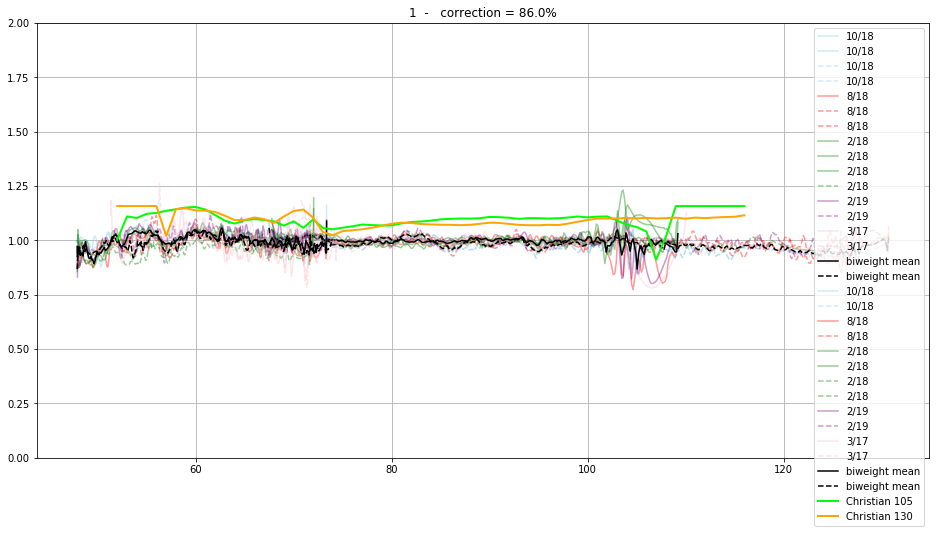

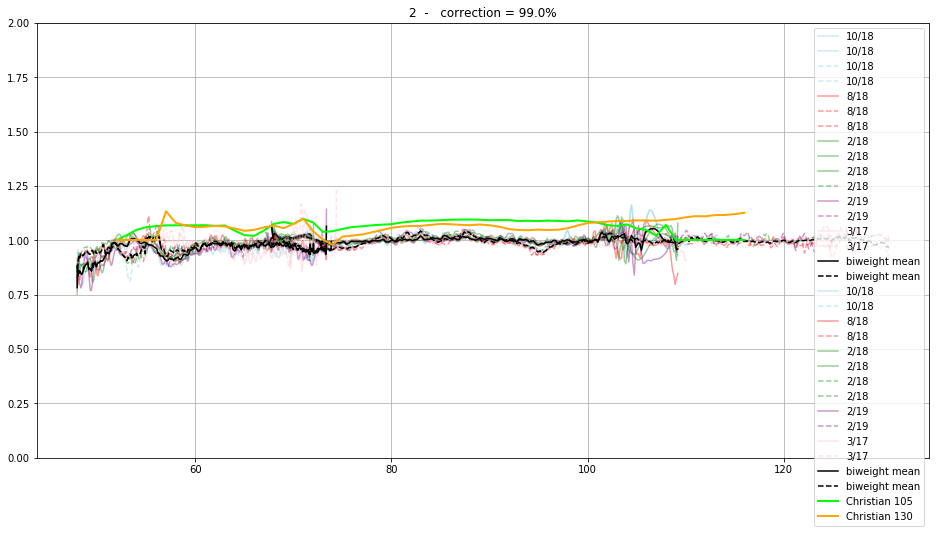

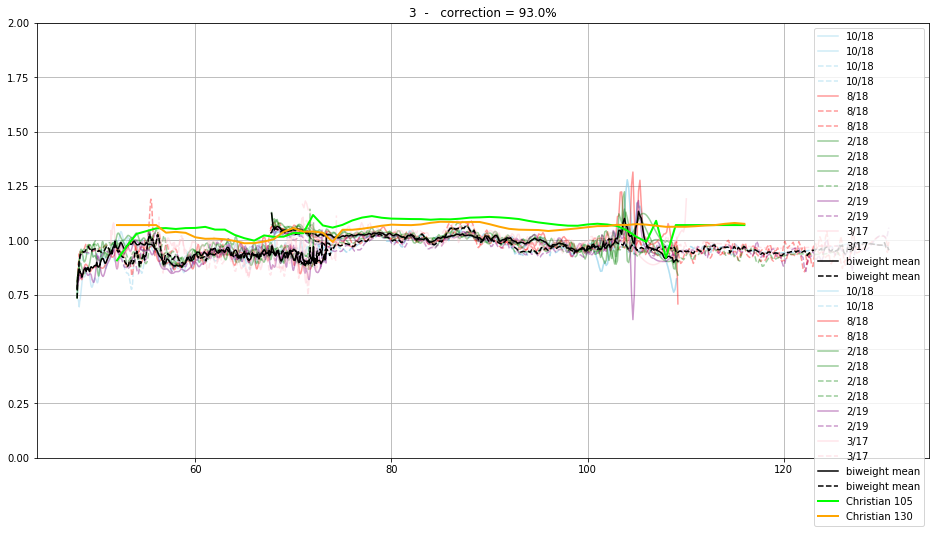

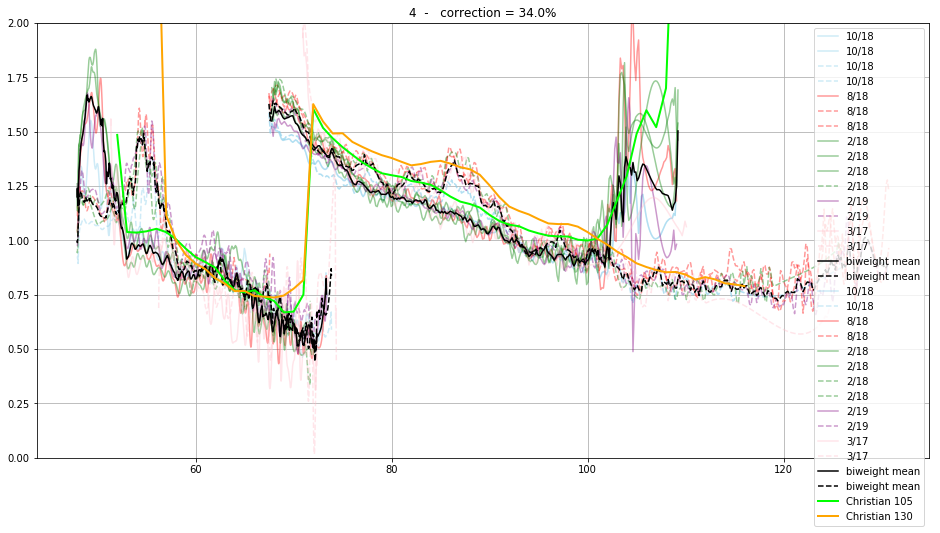

...

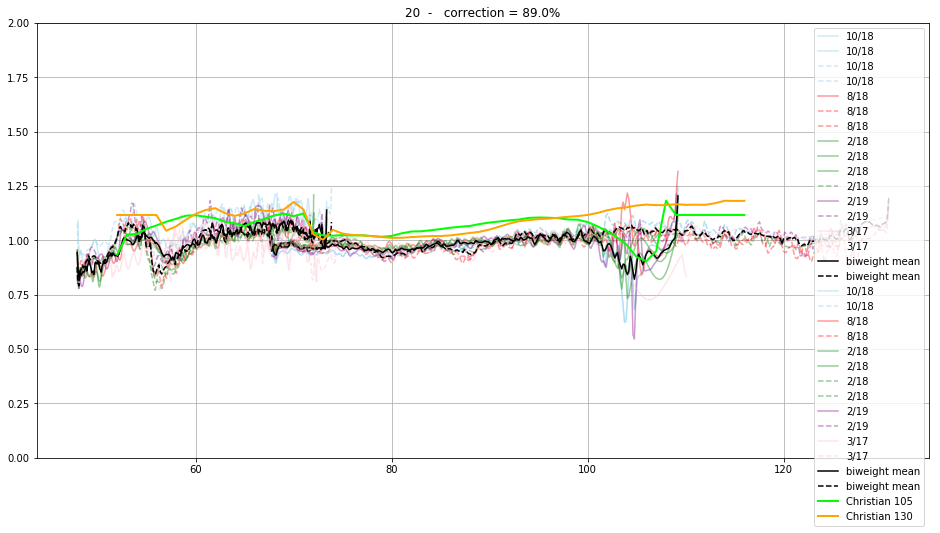

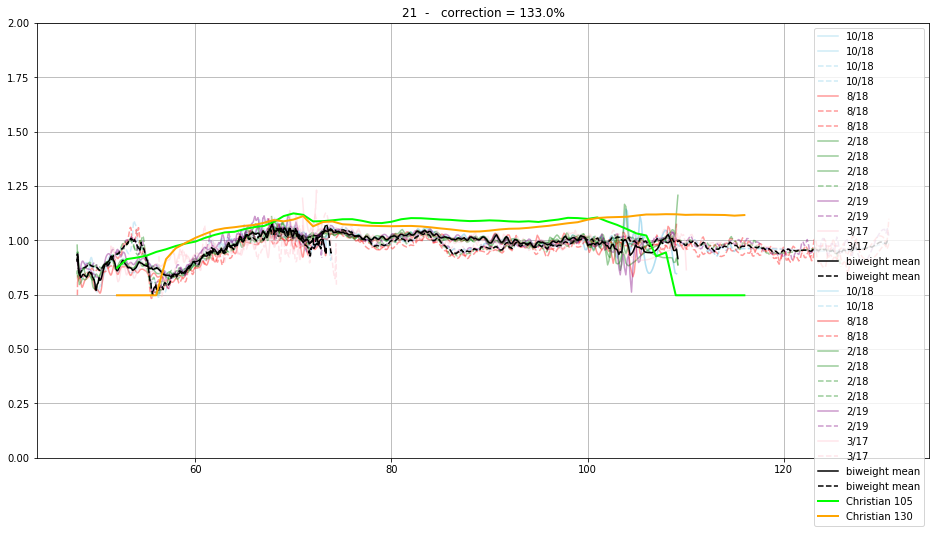

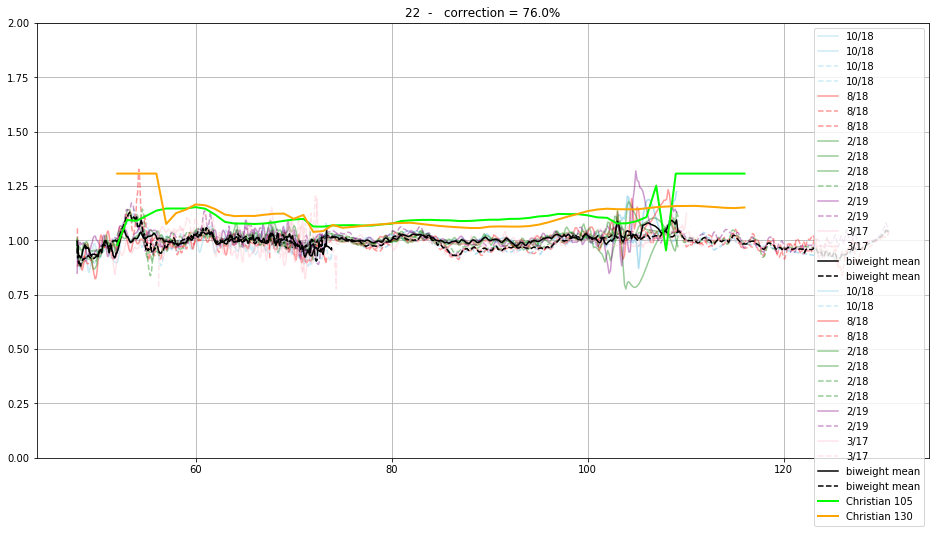

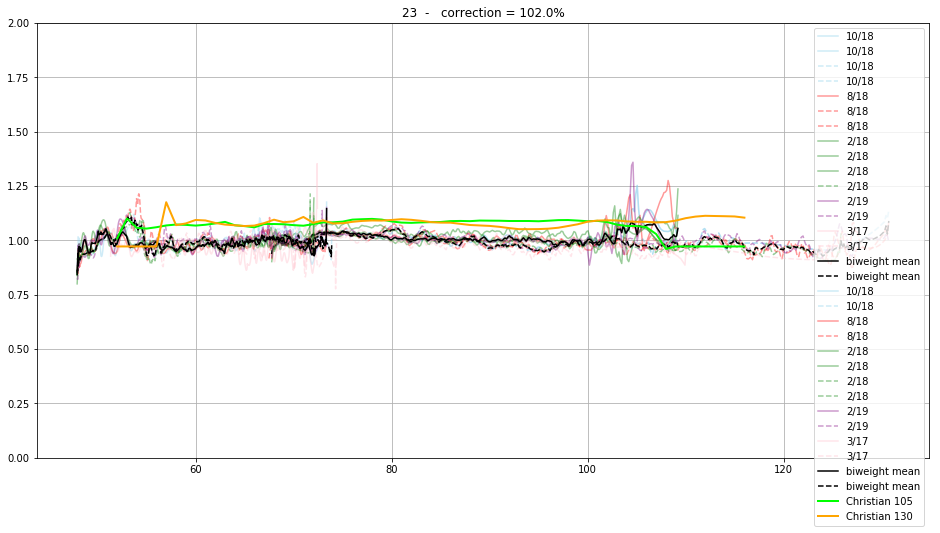

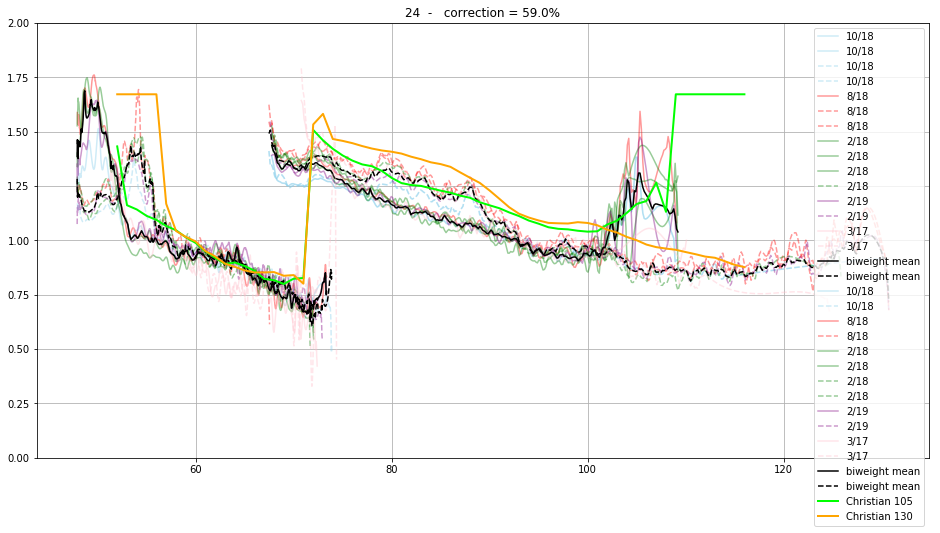

In [5]:
from fifipy.stats import biweightLocation

spaxelSpectralFlat1A = []
spaxelSpectralFlat2A = []
spaxelSpectralFlat1B = []
spaxelSpectralFlat2B = []
#mask = [1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
mask = [1,2,6,7,8,11,12,13,16,17,20,21,22]
#mask = range(25)

for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    specA = []
    specB = []
    for w, s, d, dic in zip(waves1, spatspectra1, dates1, dichroics1):
        meds = biweightLocation(s[mask,:], axis = 0)
        if d == '10/18':
            color='skyblue'
            ss = s1
        elif d == '8/18':
            color='red'
            ss = s2
        elif d == '2/18':
            color='green'
            ss = s3
        elif d == '3/17':
            color='pink'
            ss = s4
        elif d == '2/19':
            color='purple'
            ss = s5
        else:
            color='black'
        if dic == 105:
            line = '-'
        else:
            line = '--'
        if dic == 105:
            specA.append(s[ispax,:]/meds/ss[ispax])
        else:
            specB.append(s[ispax,:]/meds/ss[ispax])
        ax.plot(w, s[ispax,:]/meds/ss[ispax], line, label = d, color=color,alpha=0.4)
    specA = np.array(specA)
    ssf = biweightLocation(specA, axis=0)
    ax.plot(w, ssf, color='black',label='biweight mean')
    spaxelSpectralFlat1A.append(ssf)
    specB = np.array(specB)
    ssf = biweightLocation(specB, axis=0)
    ax.plot(w, ssf, '--', color='black',label='biweight mean')
    spaxelSpectralFlat1B.append(ssf)

    specA = []
    specB = []
    for w, s, d, dic in zip(waves2, spatspectra2, dates2, dichroics2):
        meds = biweightLocation(s[mask,:], axis = 0)
        if d == '10/18':
            color='skyblue'
            ss = s1
        elif d == '8/18':
            color='red'
            ss = s2
        elif d == '2/18':
            color='green'
            ss = s3
        elif d == '3/17':
            color='pink'
            ss = s4
        elif d == '2/19':
            color='purple'
            ss = s5
        else:
            color='black'
        if dic == 105:
            line = '-'
        else:
            line = '--'
        if dic == 105:
            specA.append(s[ispax,:]/meds/ss[ispax])
        else:
            specB.append(s[ispax,:]/meds/ss[ispax])
        ax.plot(w, s[ispax,:]/meds/ss[ispax], line, label = d, color=color,alpha=0.4)
    specA = np.array(specA)
    ssf = biweightLocation(specA, axis=0)
    ax.plot(w, ssf, color='black',label='biweight mean')
    spaxelSpectralFlat2A.append(ssf)
    specB = np.array(specB)
    ssf = biweightLocation(specB, axis=0)
    ax.plot(w, ssf, '--', color='black',label='biweight mean')
    spaxelSpectralFlat2B.append(ssf)
    ax.plot(wch, ff105[:,ispax]/s4[ispax],color='lime',label='Christian 105',linewidth=2)
    ax.plot(wch, ff130[:,ispax]/s4[ispax],color='orange',label='Christian 130',linewidth=2)
    
    ax.legend()
    ax.set_title(str(ispax) + '  -   correction = ' + str(ss[ispax]*100//1) + '%')
    ax.set_ylim([0,2])
    ax.grid()
    plt.show()


# Step 3

Run the spectral flats after correcting for common spectral flat.

In [6]:
# Copy the spectra
corrSpectra = spectra.copy()

# Apply the corrections spaxelSpectralFlat
w = waves[0]
w1 = waves1[0]
w2 = waves2[0]
for s, o, d in zip(corrSpectra, orders, dichroics):
    # Choice of flat
    if o == 1:
        wi = w1
        if d == 105:
            sflat = spaxelSpectralFlat1A
        else:
            sflat = spaxelSpectralFlat1B
    else:
        wi = w2
        if d == 105:
            sflat = spaxelSpectralFlat2A
        else:
            sflat = spaxelSpectralFlat2B
    # Interpolation & flat
    for i, sf in enumerate(sflat):
        sfi = np.interp(w, wi, sf)
        for j in range(16):
            s[i*16+j,:] /= sfi

            
# Recompute spat spectra using the corrected spectra
spatspectra = []
for spectrum in corrSpectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)
spatspectra = np.array(spatspectra)


In [7]:
# Check on spatspectra and update si (spatial flats)
w = waves[0]
i1 = dates == '10/18'
i2 = dates == '8/18'
i3 = dates == '2/18'
i4 = dates == '3/17'
i5 = dates == '2/19'
for ispax in range(25):
    med = []
    for ss, date in zip(spatspectra, dates):
        smed = biweightLocation(ss, axis=0)
        if date == '10/18':
            si = s1
        elif date == '8/18':
            si = s2
        elif date == '2/18':
            si = s3
        elif date == '3/17':
            si = s4
        elif date == '2/19':
            si = s5
        med.append(biweightLocation(ss[ispax,:]/smed/si[ispax]))
    med = np.array(med)
    if Test:
        print('Spaxel ', ispax+1)
    for ii, si in zip([i1,i2,i3,i4,i5],[s1,s2,s3,s4,s5]):
        mi = biweightLocation(med[ii])
        si[ispax] *= mi
        if Test:
            print(mi)
    if Test:
        fig,ax = plt.subplots(figsize=(16,8))
        for ss, date in zip(spatspectra, dates):
            smed = biweightLocation(ss, axis=0)
            if date == '10/18':
                si = s1
            elif date == '8/18':
                si = s2
            elif date == '2/18':
                si = s3
            elif date == '3/17':
                si = s4
            elif date == '2/19':
                si = s5
            ax.plot(w, ss[ispax,:]/smed/si[ispax])
        ax.set_title('spaxel '+ str(ispax))
        ax.grid()
        ax.set_ylim(0,2)
        plt.show()

In [8]:
# TEST
%matplotlib inline
from fifipy.spectra import computeFlatBlue
if Test:
    wdario = np.arange(49,125,0.2)
    ispax = 14
    ispex = 12
    fig,ax = plt.subplots(figsize=(16,8))
    flats = computeFlatBlue(waves,corrSpectra,spatspectra,ispax,ispex,minflat=0.5,maxflat=1.2,delta=2)
    for w,cs,ss,d,o in zip(waves, corrSpectra, spatspectra, dichroics, orders):
        if d == 105:
            if o == 1:
                color='blue'
            else:
                color='skyblue'
        else:
            if o == 1:
                color='red'
            else:
                color='orange'
        ax.plot(w,cs[ispax*16+ispex]/ss[ispax],'.',markersize=0.9,color=color,linewidth=0.5)
    ax.plot(wch, f105[:,ispax,ispex],color='skyblue',label='Christian 105',linewidth=2)
    ax.plot(wch, f130[:,ispax,ispex],color='orange',label='Christian 130',linewidth=2)
    if flats is not None:
        flat, eflat = flats
        f = flat(wdario)
        ef = eflat(wdario)
        ax.plot(wdario,f,color='green',label='My flat ['+str(ispax+1)+','+str(ispex+1)+']',linewidth=2.)
        ax.plot(wdario,f+3*ef, color='green', linewidth=1.)
        ax.plot(wdario,f-3*ef, color='green', linewidth=1.)
    ax.set_xlim([45,130])
    ax.set_ylim([0.5,1.49])
    ax.legend()
    plt.show()

/Users/dfadda/Python/fifipy/fifipy/spectra.py:178: RuntimeWarning: invalid value encountered in less
  m = (fi < minflat) | (fi > maxflat)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:178: RuntimeWarning: invalid value encountered in greater
  m = (fi < minflat) | (fi > maxflat)


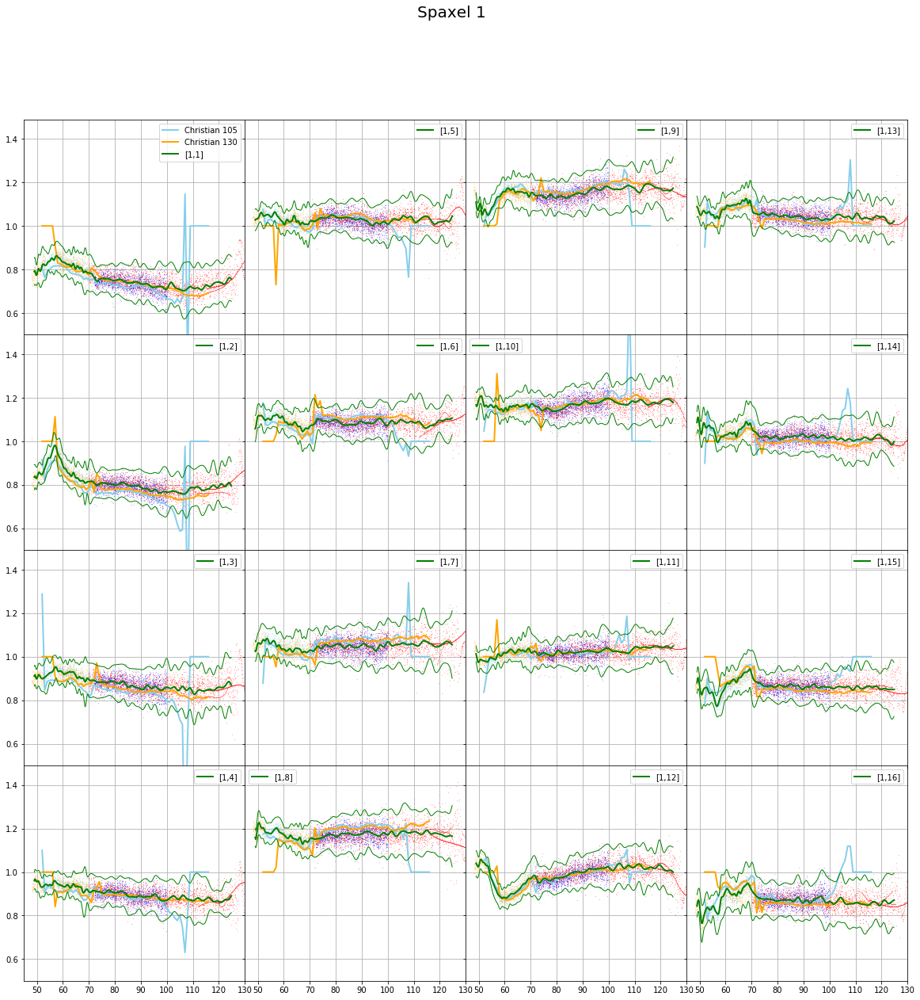

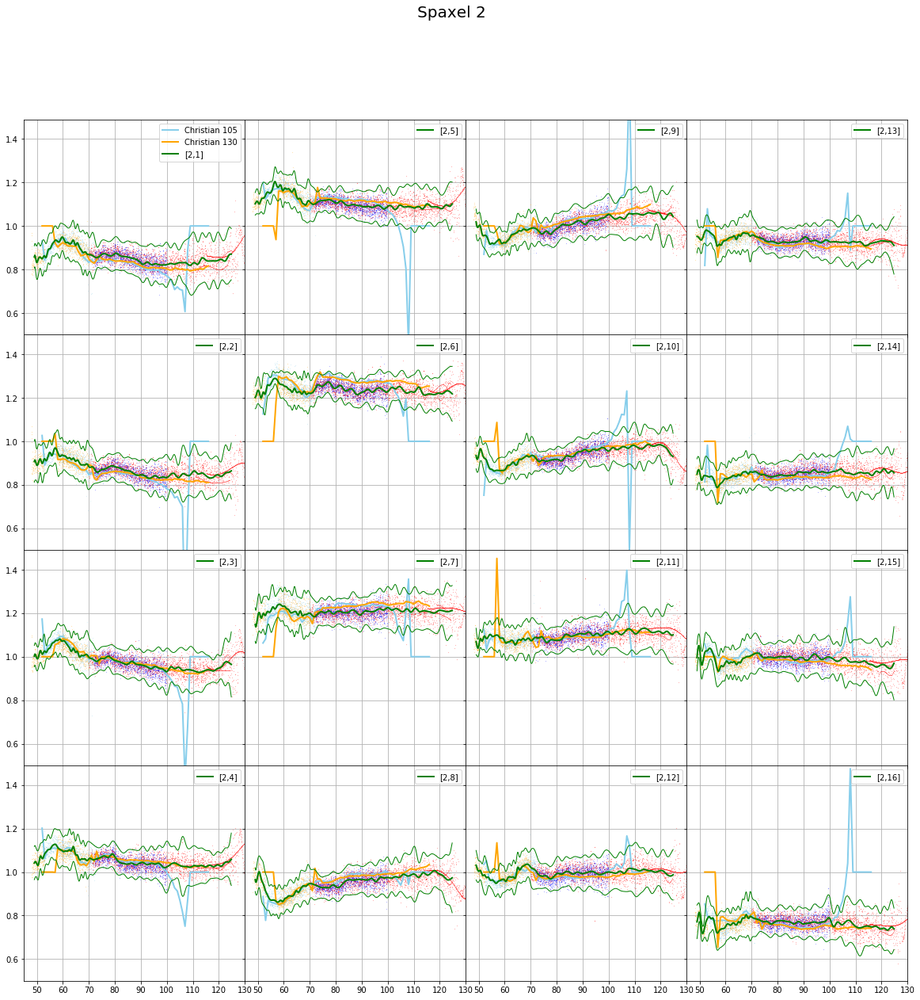

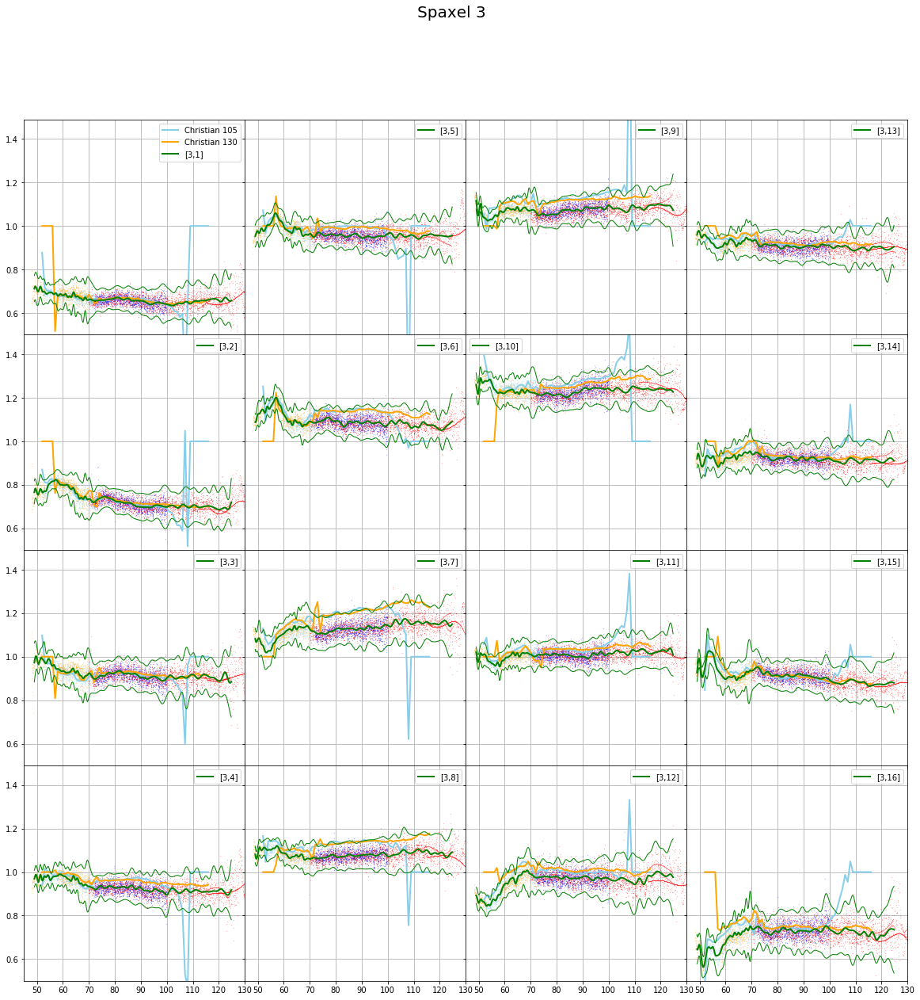

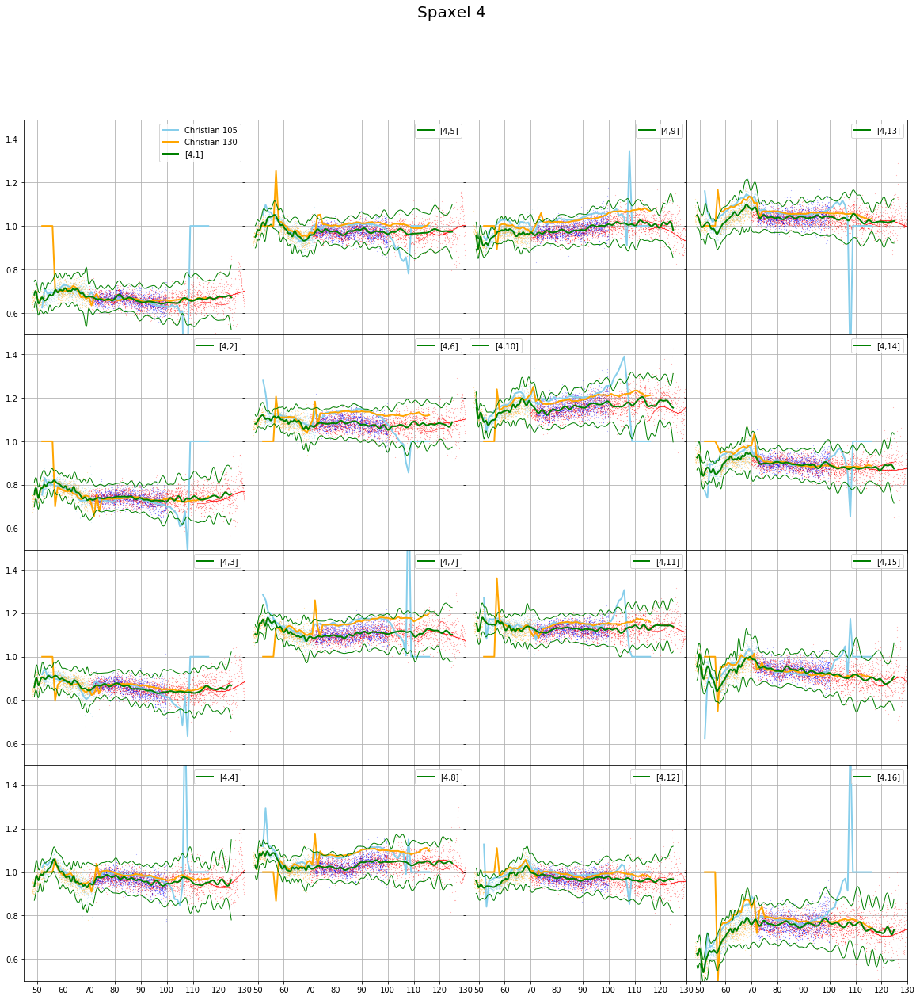

/Users/dfadda/Python/fifipy/fifipy/spectra.py:200: RuntimeWarning: invalid value encountered in less
  mask = np.abs(med - mf) < 10*mad


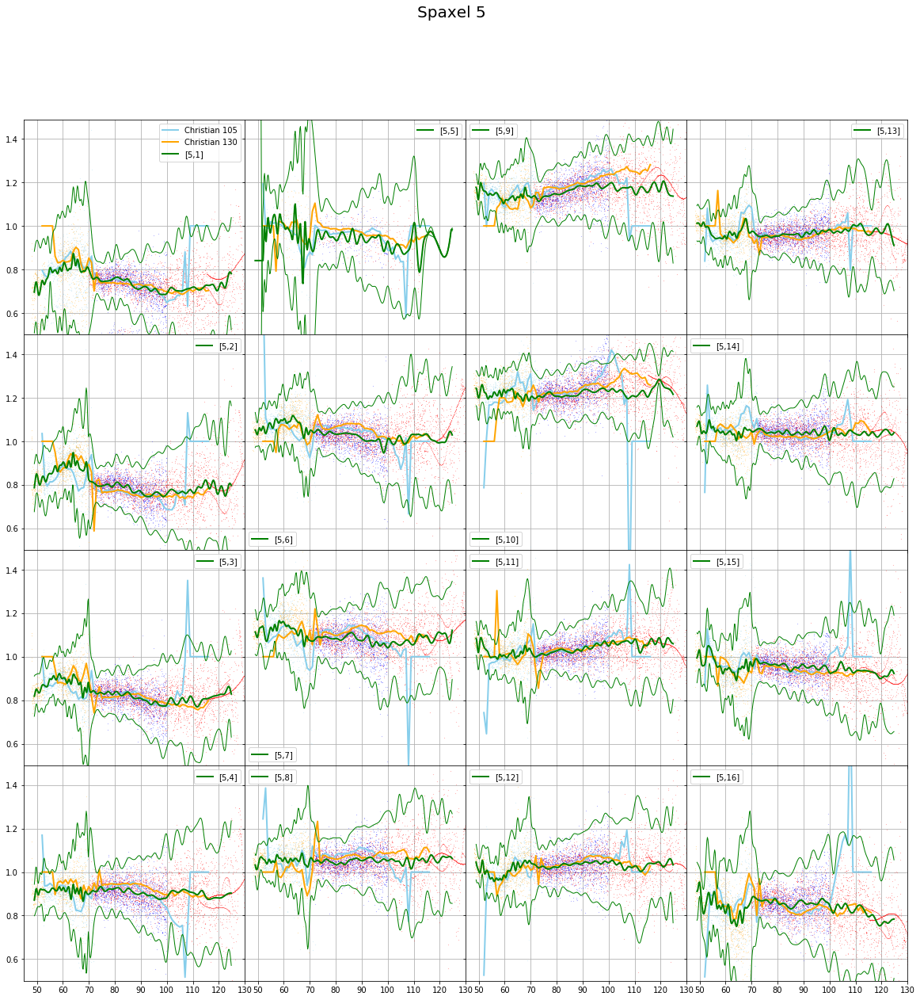

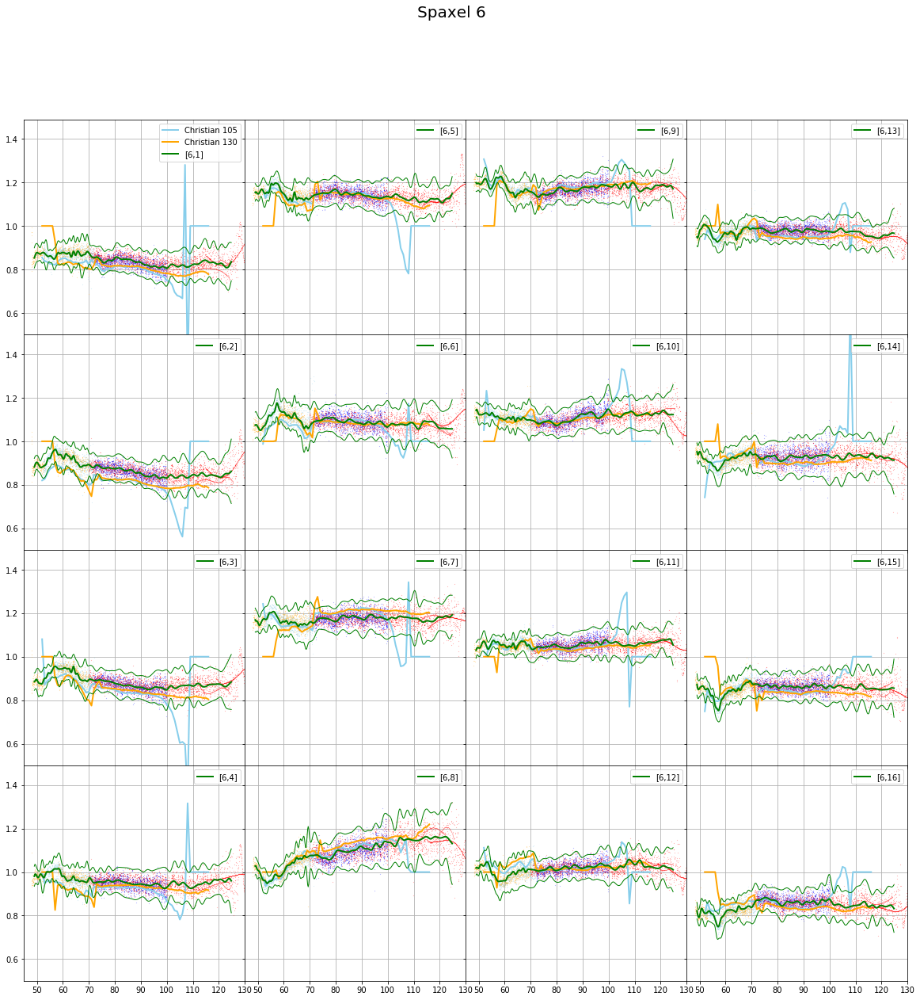

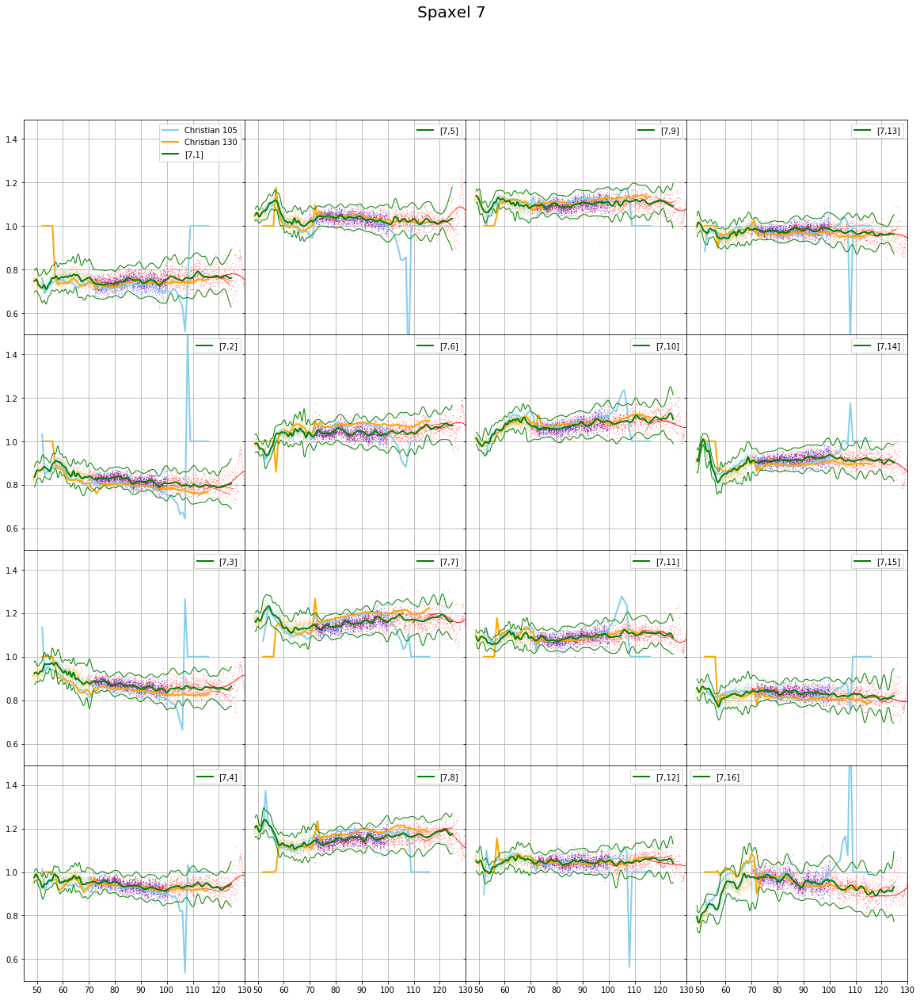

No handles with labels found to put in legend.


There are no arrays to concatenate


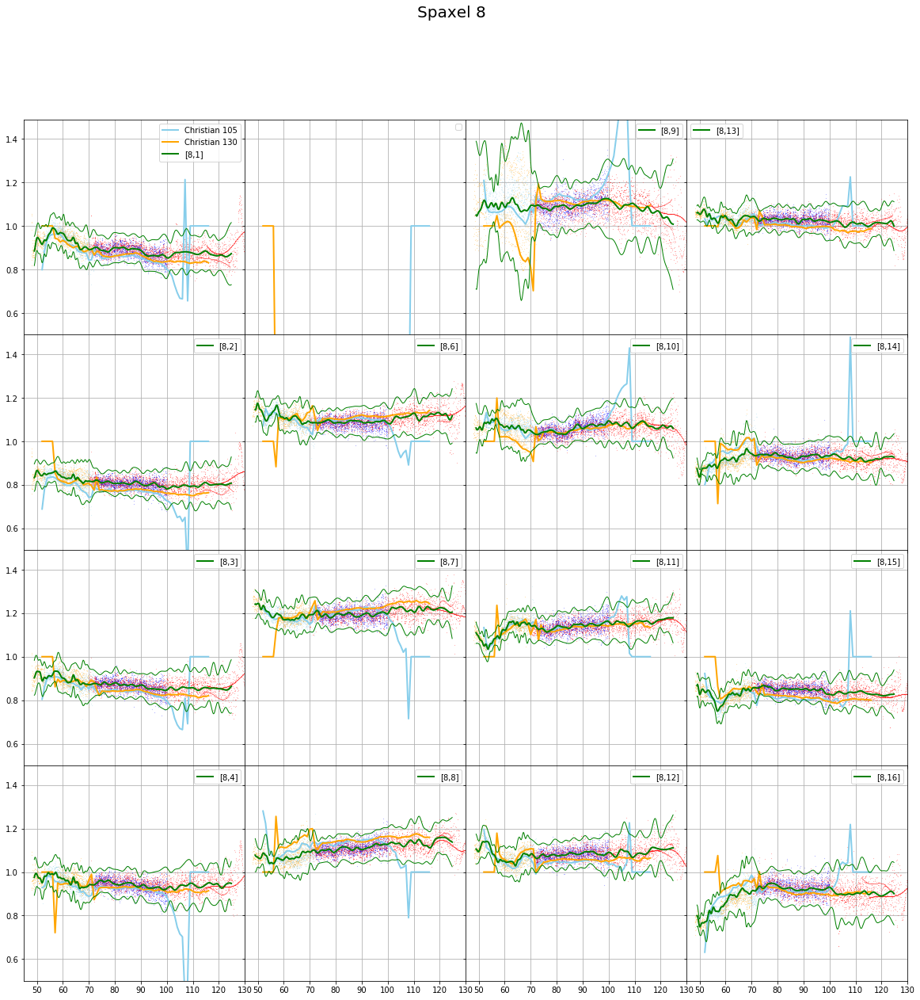

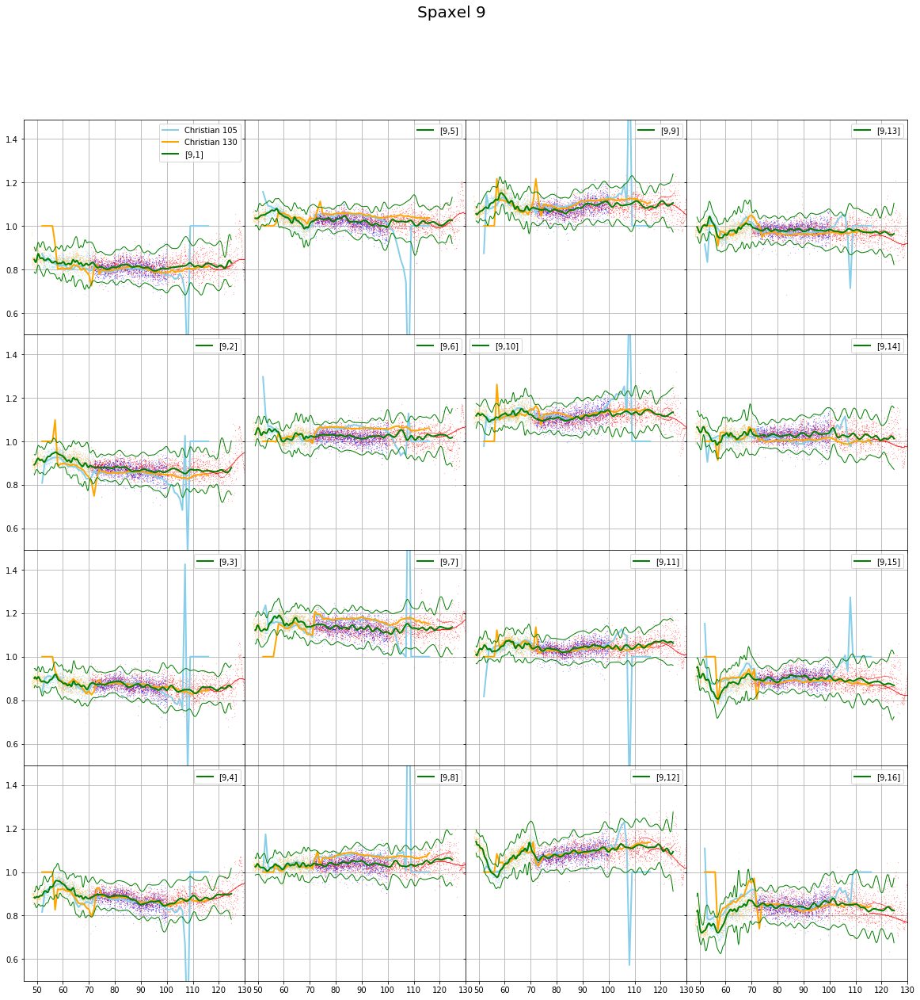

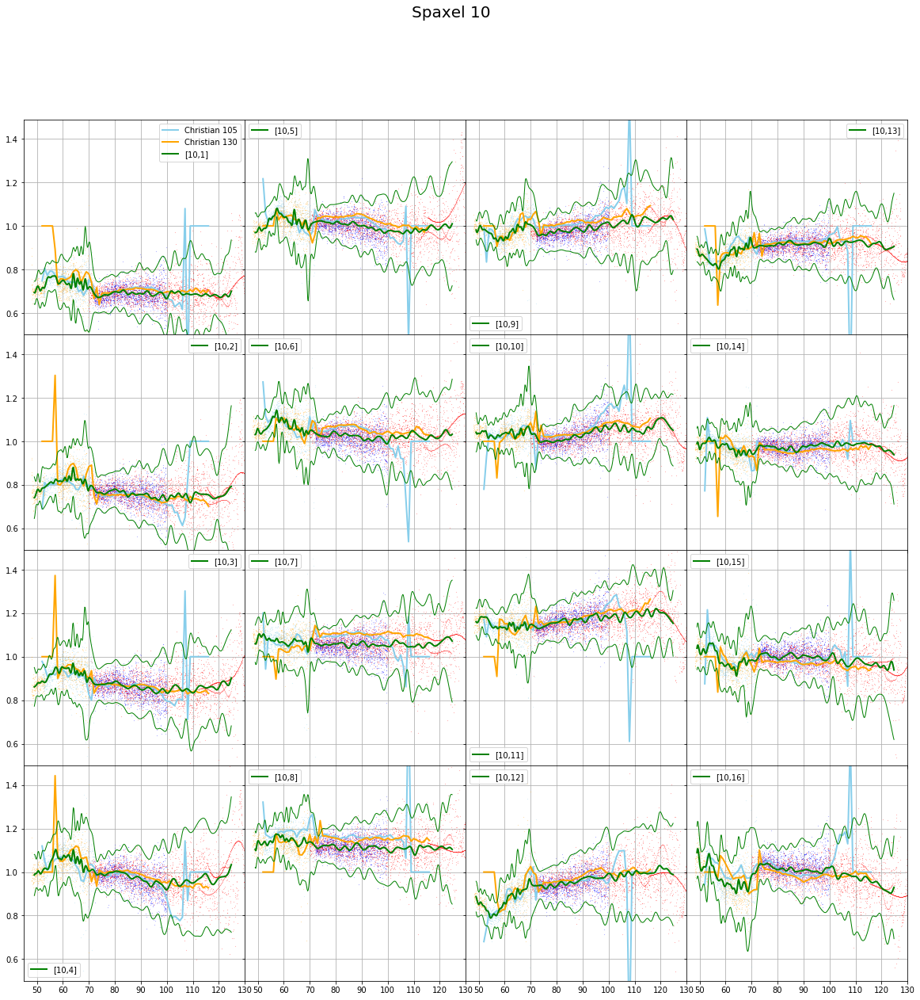

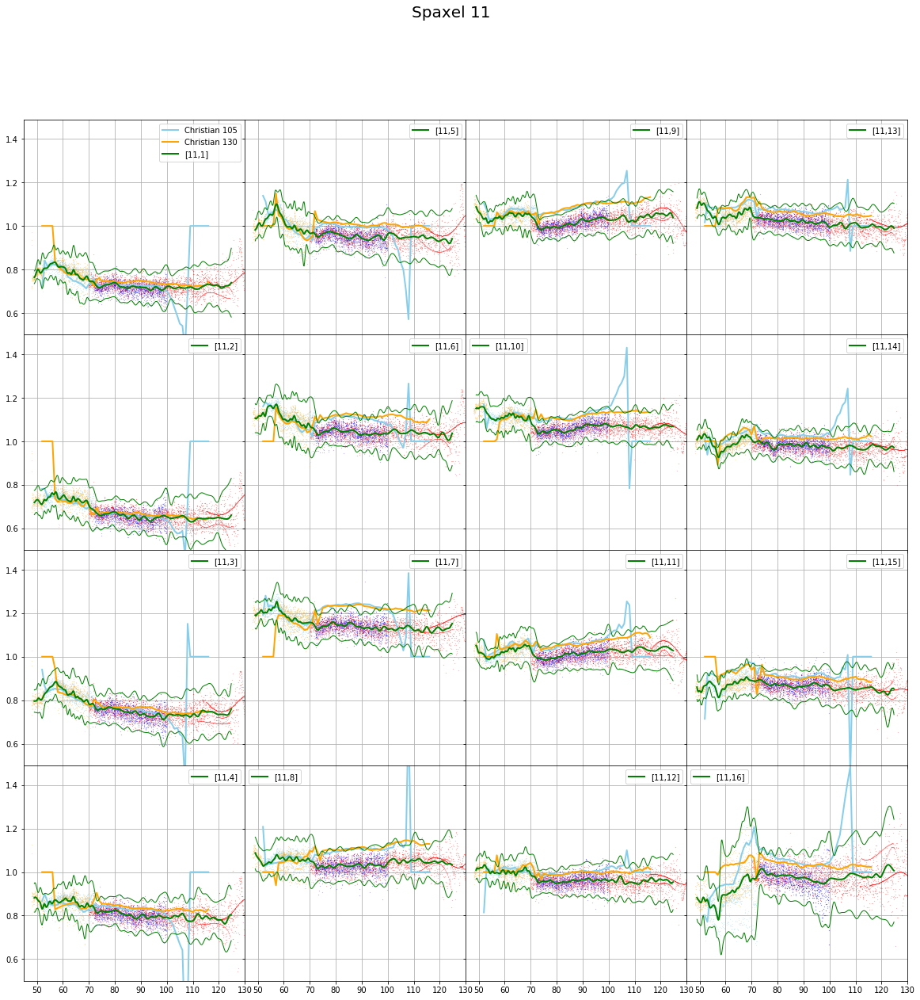

No handles with labels found to put in legend.
No handles with labels found to put in legend.


There are no arrays to concatenate
There are no arrays to concatenate


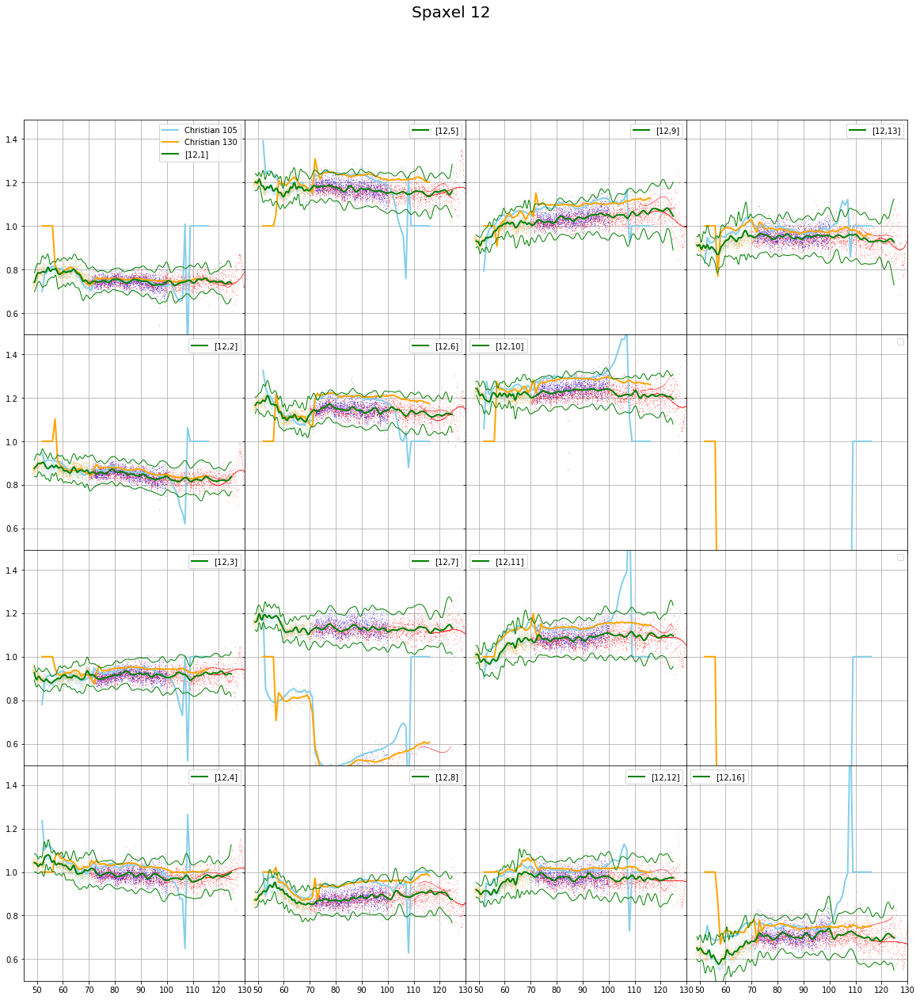

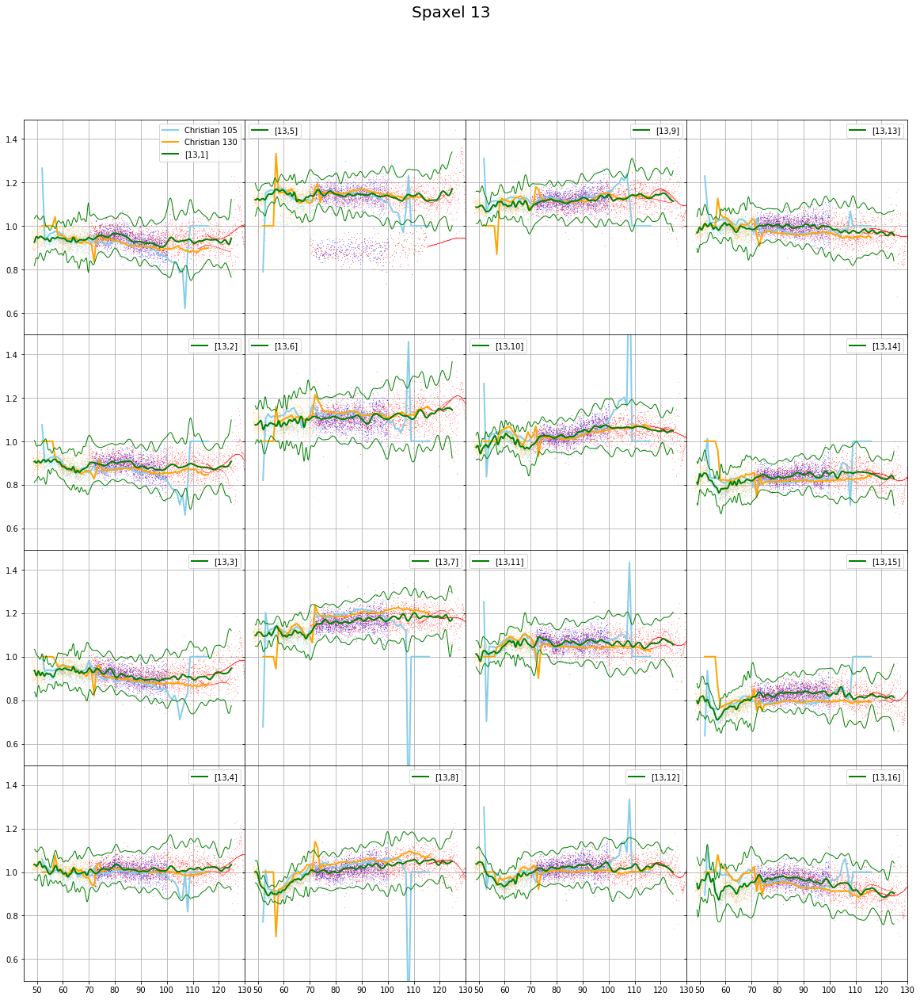

No handles with labels found to put in legend.


There are no arrays to concatenate


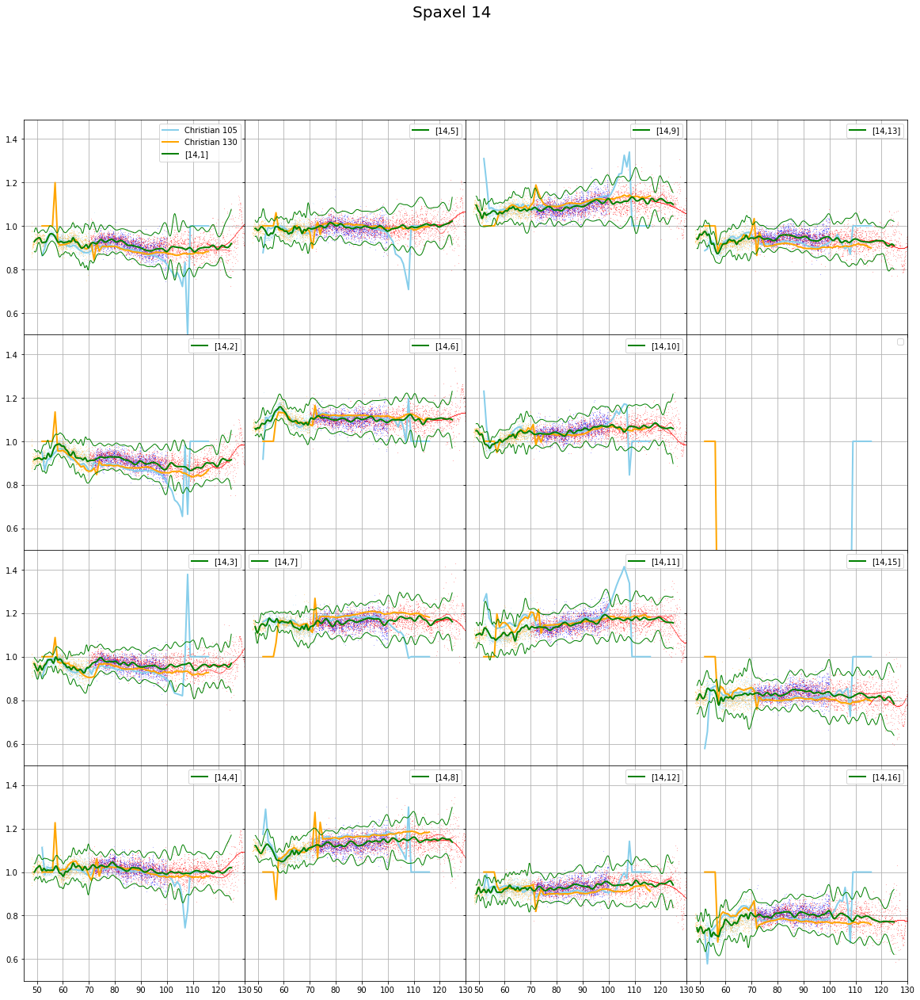

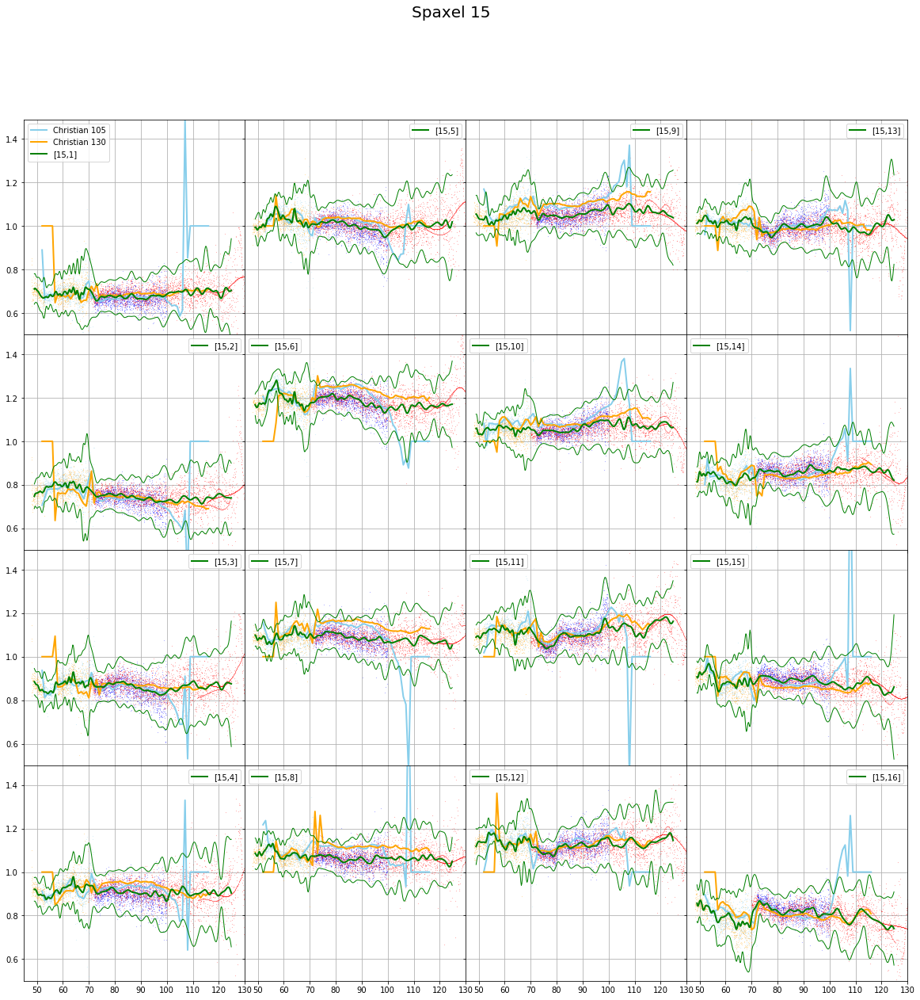

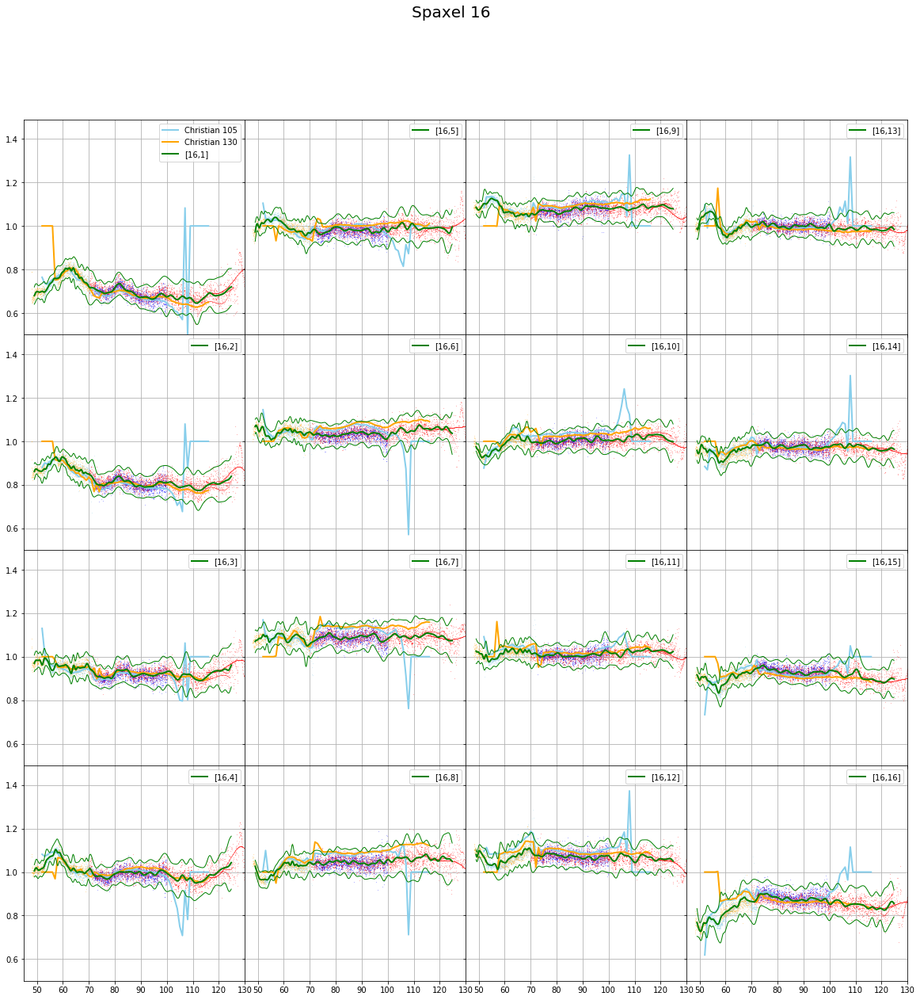

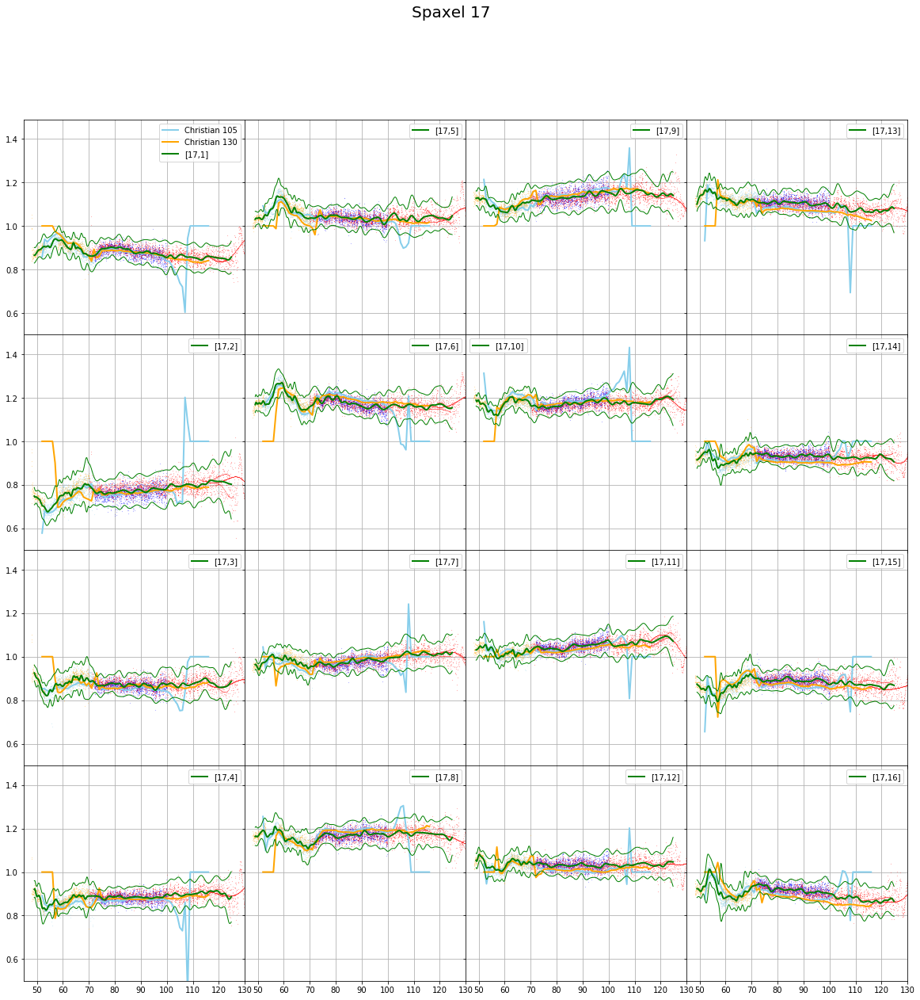

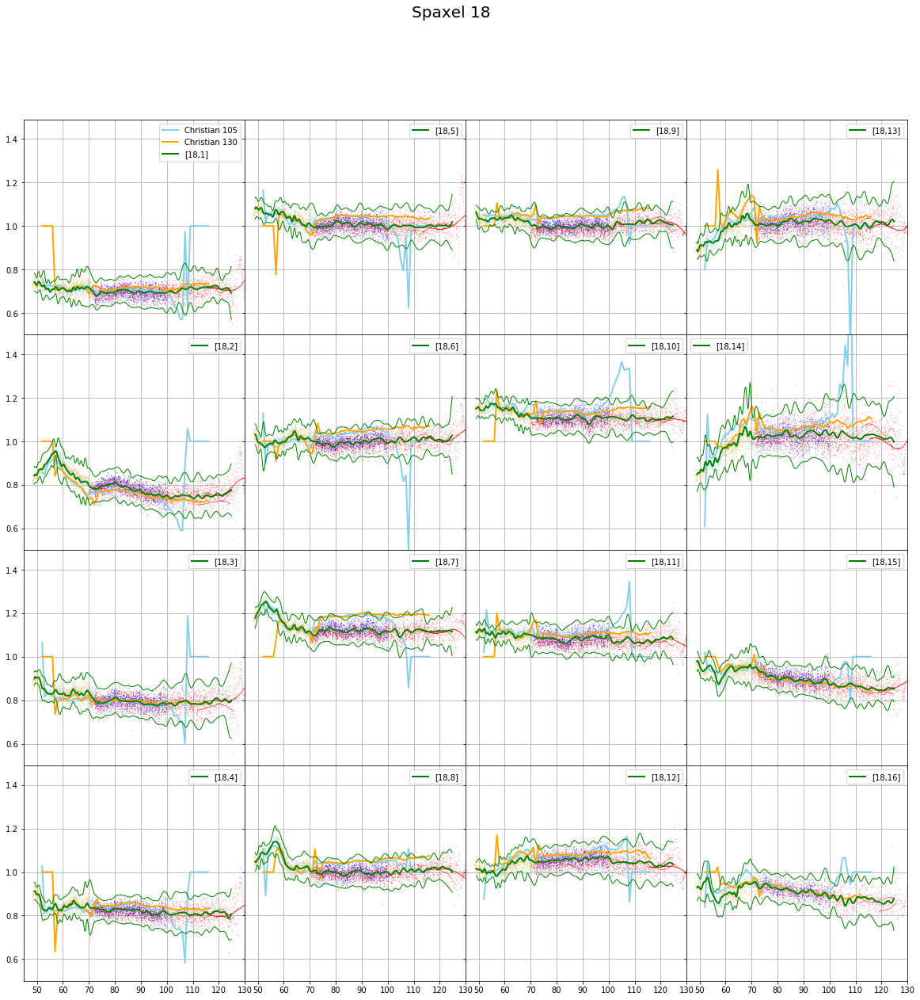

No handles with labels found to put in legend.


There are no arrays to concatenate


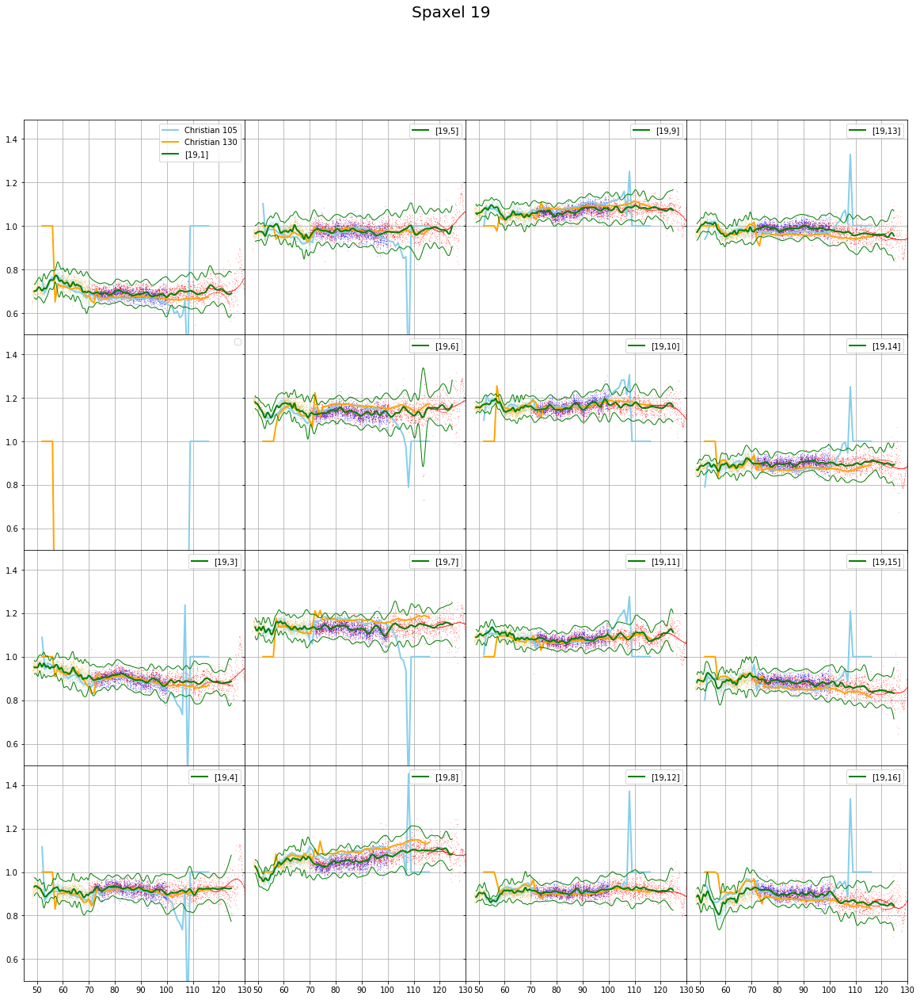

No handles with labels found to put in legend.


There are no arrays to concatenate


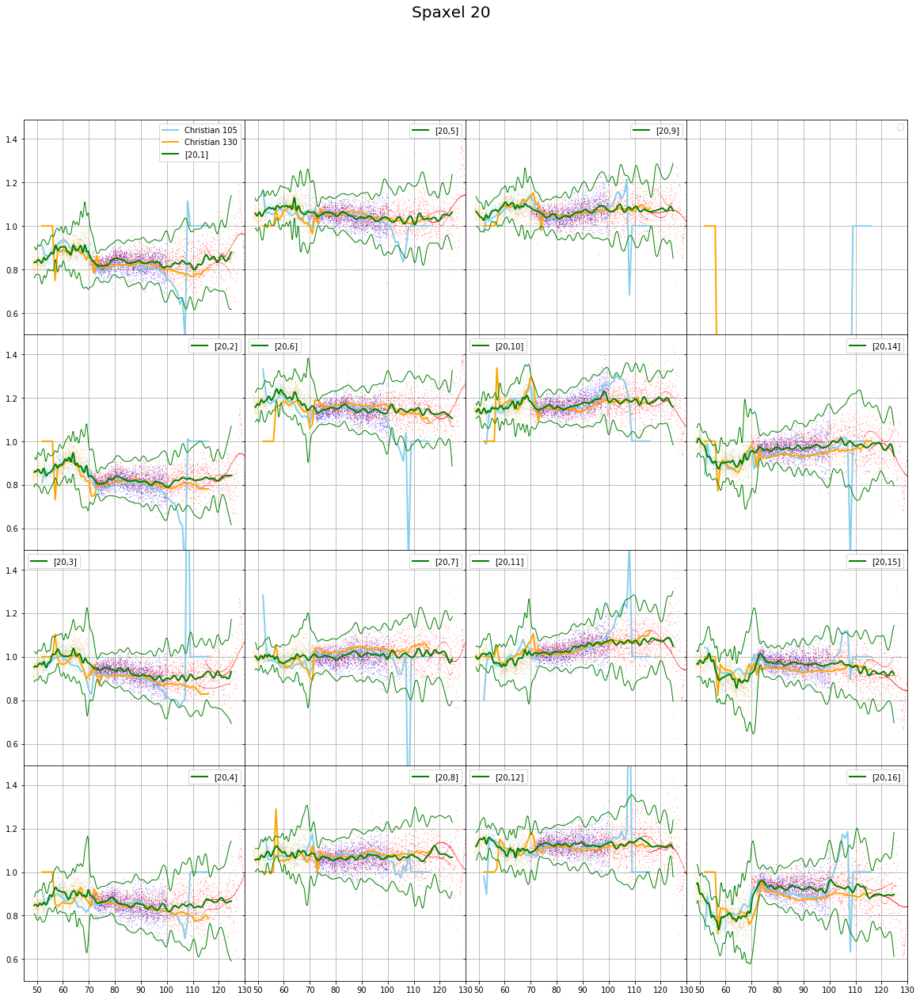

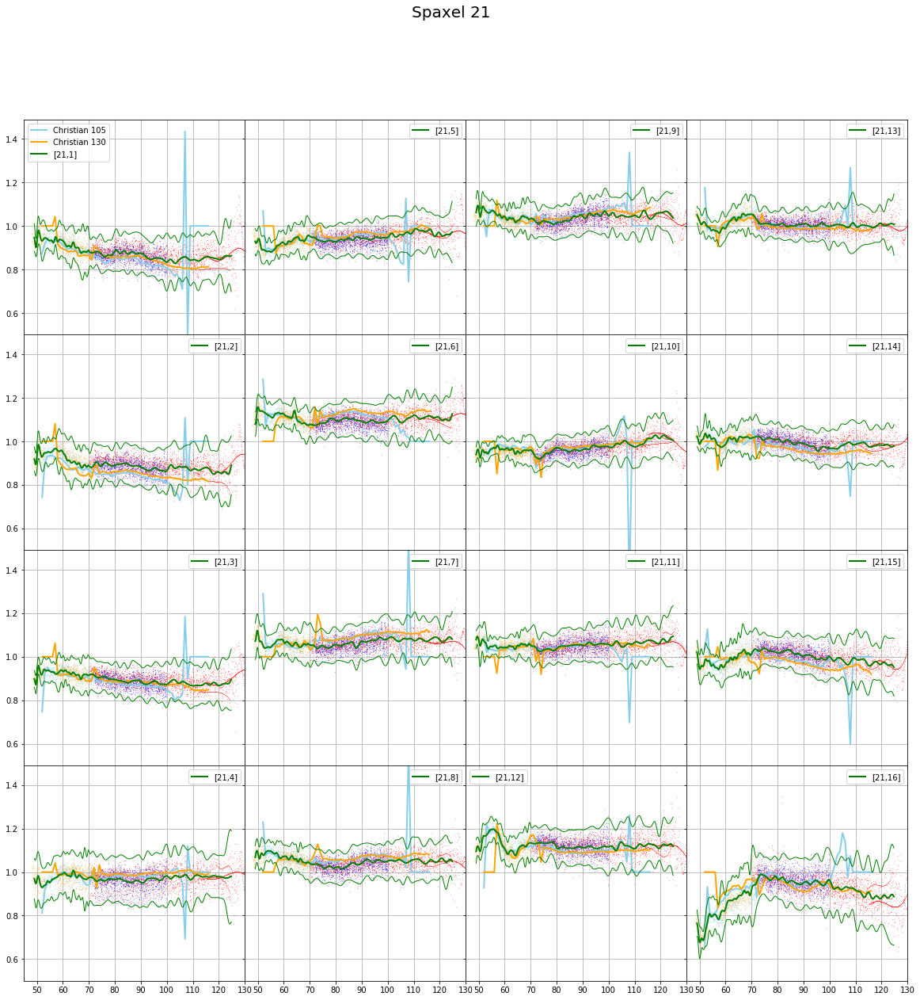

No handles with labels found to put in legend.


There are no arrays to concatenate


No handles with labels found to put in legend.


There are no arrays to concatenate


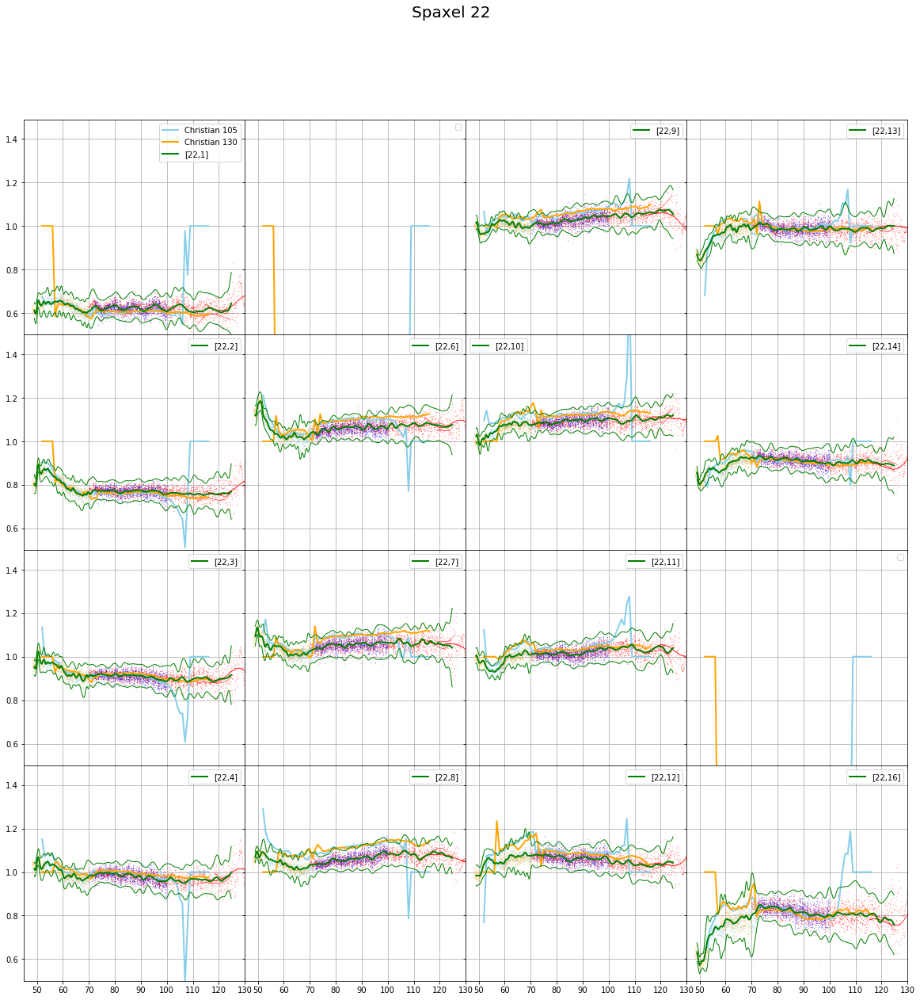

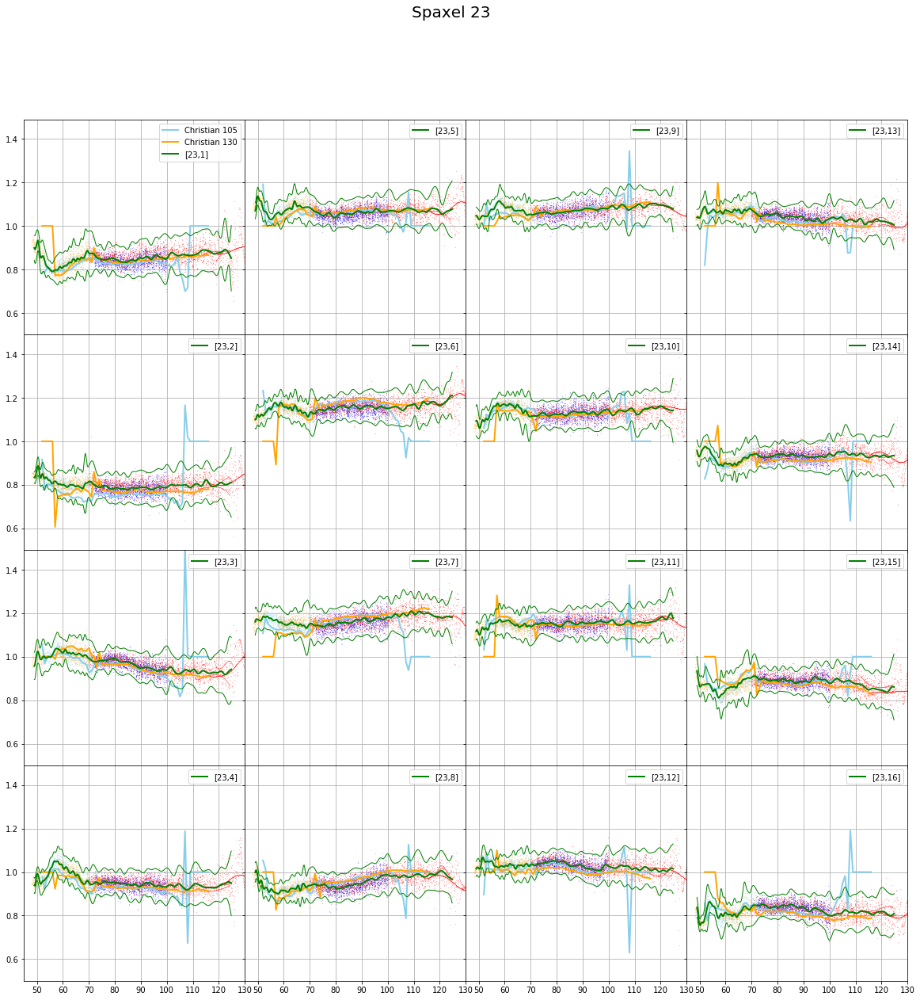

No handles with labels found to put in legend.


There are no arrays to concatenate


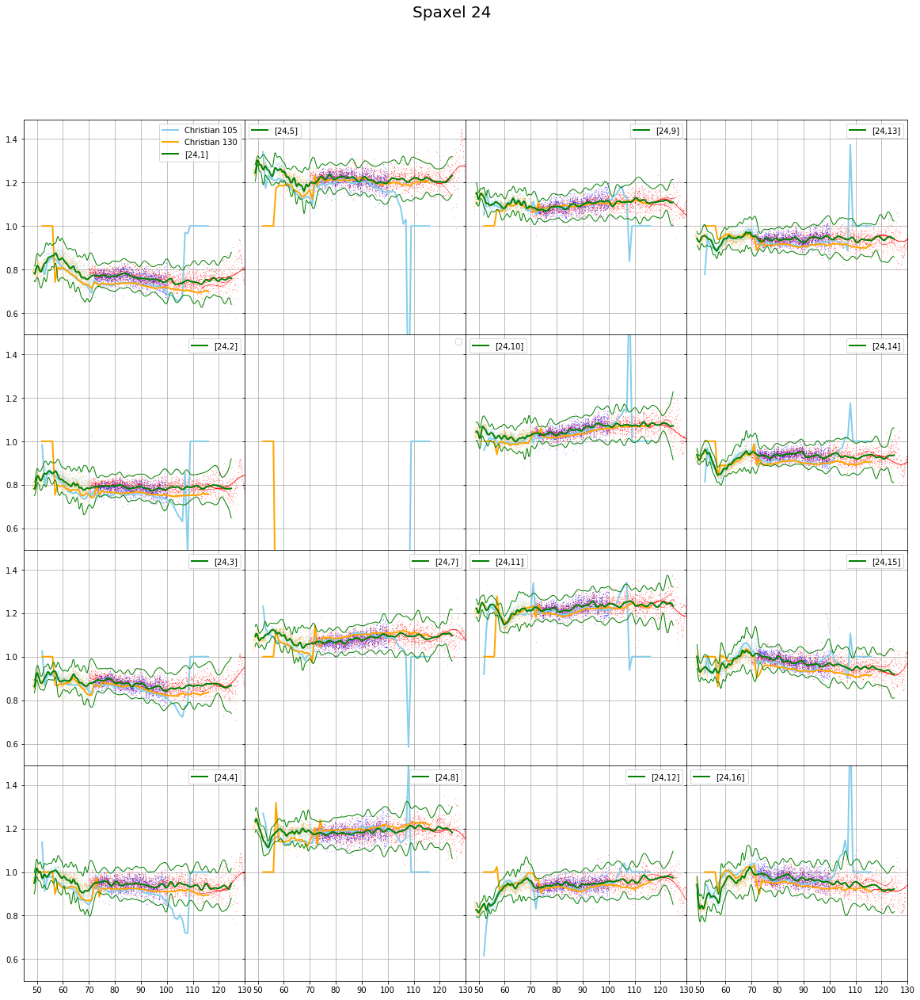

In [ ]:
%matplotlib inline
from fifipy.spectra import computeFlatBlue
wdario = np.arange(49,125,0.2)
fdario = np.ones((np.size(wdario),25,16))
efdario = np.ones((np.size(wdario),25,16))

badpix = []
for ispax in range(25):
    # Flats
    fig,axes = plt.subplots(4,4,figsize=(20,20), sharex=True, sharey=True)
    for ispex in range(16):
        flats = computeFlatBlue(waves,corrSpectra,spatspectra,ispax,ispex,minflat=0.5,maxflat=1.3,delta=1.5)
        ax = axes[ispex % 4, ispex // 4] 
        for w,cs,ss,d,o in zip(waves, corrSpectra, spatspectra, dichroics, orders):
            if d == 105:
                if o == 1:
                    color='blue'
                else:
                    color='skyblue'
            else:
                if o == 1:
                    color='red'
                else:
                    color='orange'
            ax.plot(w,cs[ispax*16+ispex]/ss[ispax],'.',markersize=0.2,color=color,linewidth=0.5)
        if ispex == 0:
            ax.plot(wch, f105[:,ispax,ispex],color='skyblue',label='Christian 105',linewidth=2)
            ax.plot(wch, f130[:,ispax,ispex],color='orange',label='Christian 130',linewidth=2)
        else:
            ax.plot(wch, f105[:,ispax,ispex],color='skyblue', linewidth=2)
            ax.plot(wch, f130[:,ispax,ispex],color='orange', linewidth=2)
        if flats is not None:
            flat, eflat = flats
            f = flat(wdario)
            ef = eflat(wdario)
            ax.plot(wdario,f,color='green',label='['+str(ispax+1)+','+str(ispex+1)+']',linewidth=2.)
            ax.plot(wdario,f+3*ef, color='green', linewidth=1.)
            ax.plot(wdario,f-3*ef, color='green', linewidth=1.)
            fdario[:,ispax,ispex] = f
            efdario[:,ispax,ispex] = ef
        else:
            badpix.append((ispax+1, ispex+1))
        ax.set_xlim([45,130])
        ax.set_ylim([0.5,1.49])
        ax.legend()
        ax.grid()
    fig.suptitle('Spaxel '+str(ispax + 1), fontsize=20)
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()
    
print("badpixels: ")
for bad in badpix:
    print(bad)

In [ ]:
# Combine spectral flats (per spexal) with spectral flat (per spexel)
# to obtain total spexel spectral flats and respective wavelength arrays

# B1 - D105
idx = np.isfinite(spaxelSpectralFlat1A[20])
w1min = np.nanmin(w1[idx])
w1max = np.nanmax(w1[idx])
print('min max w1 ', w1min, w1max)
idx, = np.where( (wdario >= w1min) & (wdario <= w1max))
w105b1 = wdario[idx]
spexelSpectralFlatB1D105 = fdario[idx,:,:].copy()
efB1D105 = efdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatB1D105))
for ispax, sft in enumerate(spaxelSpectralFlat1A):
    sft_ = np.interp(w105b1, w1, sft)
    for ispex in range(16):
        spexelSpectralFlatB1D105[:,ispax,ispex] *= sft_
# B1 - D130
idx = np.isfinite(spaxelSpectralFlat1B[20])
w1min = np.nanmin(w1[idx])
w1max = np.nanmax(w1[idx])
print('min max w1 ', w1min, w1max)
idx, = np.where( (wdario >= w1min) & (wdario <= w1max))
w130b1 = wdario[idx]
spexelSpectralFlatB1D130 = fdario[idx,:,:].copy()
efB1D130 = efdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatB1D130))
for ispax, sft in enumerate(spaxelSpectralFlat1B):
    sft_ = np.interp(w130b1, w1, sft)
    for ispex in range(16):
        spexelSpectralFlatB1D130[:,ispax,ispex] *= sft_        
# B2 - D105
idx = np.isfinite(spaxelSpectralFlat2A[20])
w2min = np.nanmin(w2[idx])
w2max = np.nanmax(w2[idx])
print('min max w2 ', w2min, w2max)
idx, = np.where( (wdario >= w2min) & (wdario <= w2max))
w105b2 = wdario[idx]
spexelSpectralFlatB2D105 = fdario[idx,:,:].copy()
efB2D105 = efdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatB2D105))
for ispax, sft in enumerate(spaxelSpectralFlat2A):
    sft_ = np.interp(w105b2, w2, sft)
    for ispex in range(16):
        spexelSpectralFlatB2D105[:,ispax,ispex] *= sft_
# B2 - D130
idx = np.isfinite(spaxelSpectralFlat2B[20])
w2min = np.nanmin(w2[idx])
w2max = np.nanmax(w2[idx])
print('min max w2 ', w2min, w2max)
idx, = np.where( (wdario >= w2min) & (wdario <= w2max))
w130b2 = wdario[idx]
spexelSpectralFlatB2D130 = fdario[idx,:,:].copy()
efB2D130 = efdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatB2D130))
for ispax, sft in enumerate(spaxelSpectralFlat2B):
    sft_ = np.interp(w130b2, w2, sft)
    for ispex in range(16):
        spexelSpectralFlatB2D130[:,ispax,ispex] *= sft_

In [ ]:
# Save the flats
import os
caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/'

from fifipy.io import saveSpecFlats
saveSpecFlats(w105b1, spexelSpectralFlatB1D105, efB1D105,'BLUE', 1, 105, caldir+'spectralFlatsB1D105.fits')
saveSpecFlats(w130b1, spexelSpectralFlatB1D130, efB1D130,'BLUE', 1, 130, caldir+'spectralFlatsB1D130.fits')
saveSpecFlats(w105b2, spexelSpectralFlatB2D105, efB2D105,'BLUE', 2, 105, caldir+'spectralFlatsB2D105.fits')
saveSpecFlats(w130b2, spexelSpectralFlatB2D130, efB2D130,'BLUE', 2, 130, caldir+'spectralFlatsB2D130.fits')

from fifipy.io import saveSpatFlats           
d1 = '20181001'
d2 = '20180801'
d3 = '20180201'
d4 = '20170301'
d5 = '20190201'
ss = np.array([s4,s3,s2,s1,s5])
dd = np.array([20180101,
                20180701,
                20180901,
                20190101,
                99999999
               ], dtype = int) #limit date to apply the flat
saveSpatFlats(ss, dd, 'BLUE', caldir+'spatialFlatB.fits')

In [ ]:
# Check on saved flats
from astropy.io import fits
hdl = fits.open('/Users/dfadda/sofia/FIFI-LS/SpectralFlats/spatialFlatB.fits')
#hdl.info()
dates = hdl['DATES'].data
flats = hdl['SPATFLAT'].data
hdl.close()

#print(dates)
fig,ax = plt.subplots(figsize=(16,8))
for f, date in zip(flats, dates):
    ax.plot(f,'o',label=str(date))
ax.grid()
ax.legend()
ax.set_title('Blue spatial flat per series')
plt.show()

In [ ]:
# Spatial illumination
if Test:
    spaflat2d = np.reshape(s5,(5,5))
    plt.imshow(spaflat2d, cmap='gray', origin='lower')
    plt.colorbar()
    plt.show()

    # Error per spexel (note that vignetted spaxels have larger errors)
    ef = np.nanmedian(efdario/fdario, axis=0)
    plt.imshow(ef, cmap='gray_r', origin='lower')
    plt.colorbar()
    plt.clim(0,.08)
    plt.show()